<a href="https://colab.research.google.com/github/paologastaldi-polito/siren/blob/master/src%5Cexplore_code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Environment initialization

In [ ]:
!pip3 install 'torch==1.3.1'
!pip3 install 'torchvision==0.5.0'
!pip3 install 'Pillow-SIMD'
!pip3 install 'tqdm'
!pip3 install 'tensorflow'

# Project initialization

###Install requirements

In [ ]:
!pip3 install 'sk-video'
!pip3 install 'cmapy'
!pip3 install 'wget'
!pip3 install 'python-box'

     |████████████████████████████████| 2.3MB 17.2MB/s 
  Created wheel for cmapy: filename=cmapy-0.6.6-cp36-none-any.whl size=3959 sha256=c02e4cb26230e0c84ef1e2779457690cb01b997012c020a5a09df023945fa758
  Stored in directory: /root/.cache/pip/wheels/6d/75/b1/b8645ff93df032bd16a383e7774e03d904476450d767fb1dcf
Successfully built cmapy
  Created wheel for wget: filename=wget-3.2-cp36-none-any.whl size=9682 sha256=4703751781e5c0bbae17b1e4100587e9c4e4cc9caa80335de4d67605e038f794
  Stored in directory: /root/.cache/pip/wheels/40/15/30/7d8f7cea2902b4db79e3fea550d7d7b85ecb27ef992b618f3f
Successfully built wget


###Reset filesystem

In [ ]:
# !rm -rf 'SRGAN-PyTorch'
# !rm -rf 'siren'
# !rm -rf 'BSDS500'
# !rm -rf 'DIV2K-loader'
# !rm -rf 'data'

### Import libraries

In [ ]:
### IMPORTANT: due to some file conflicts, import first the SRGAN code, then the SIREN one ###

import sys, os

# Clone SRGAN github repository and import the model
if not os.path.isdir('SRGAN-PyTorch'):
    !git clone 'https://github.com/twhui/SRGAN-PyTorch.git'

sys.path.append('SRGAN-PyTorch')
import models, options, utils

# Clone SIREN github repository and import the model
# if not os.path.isdir('siren'):
#     !git clone 'https://github.com/paologastaldi-polito/siren.git'
!rm -rf 'siren'
!git clone 'https://github.com/paologastaldi-polito/siren.git'

sys.path.append('siren/src/mylibs')
import myutils, mydataloader, siren, relu, loss_functions
from mydataloader import PoissonEqn
from siren import Siren
from relu import Relu

# import useful libraries
from torch.utils.data import DataLoader
import torch
import matplotlib.pyplot as plt
import time
import torch.nn.init as init
from functools import partial
from tqdm import tqdm

Cloning into 'SRGAN-PyTorch'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 250 (delta 0), reused 0 (delta 0), pack-reused 247
Receiving objects: 100% (250/250), 12.45 MiB | 32.19 MiB/s, done.
Resolving deltas: 100% (107/107), done.
Cloning into 'siren'...
remote: Enumerating objects: 326, done.
remote: Counting objects: 100% (326/326), done.
remote: Compressing objects: 100% (245/245), done.
remote: Total 1594 (delta 119), reused 201 (delta 44), pack-reused 1268
Receiving objects: 100% (1594/1594), 162.40 MiB | 40.89 MiB/s, done.
Resolving deltas: 100% (675/675), done.


### Import datasets

In [ ]:
# Import repository with the BDDS500 dataset
if not os.path.isdir('BSDS500'):
    !git clone 'https://github.com/BIDS/BSDS500.git'

# Import repository with the DIV2K dataloader
if not os.path.isdir('DIV2K-loader'):
    !git clone 'https://github.com/paologastaldi-polito/DIV2K-loader.git'
    !mv 'DIV2K-loader/DIV2K-loader.py' 'DIV2K-loader/DIV2K_loader.py'

sys.path.append('DIV2K-loader')
import DIV2K_loader
from DIV2K_loader import DIV2KImport, DIV2KImageDataset, default_transform

Cloning into 'BSDS500'...
remote: Enumerating objects: 2380, done.
remote: Total 2380 (delta 0), reused 0 (delta 0), pack-reused 2380
Receiving objects: 100% (2380/2380), 155.21 MiB | 37.38 MiB/s, done.
Resolving deltas: 100% (139/139), done.
Checking out files: 100% (2268/2268), done.
Cloning into 'DIV2K-loader'...
remote: Enumerating objects: 56, done.
remote: Counting objects: 100% (56/56), done.
remote: Compressing objects: 100% (51/51), done.
remote: Total 56 (delta 19), reused 16 (delta 4), pack-reused 0
Unpacking objects: 100% (56/56), done.
mv: cannot stat 'DIV2K-loader/DIV2K-loader.py': No such file or directory


#1 - Implement the network

In [ ]:
HIDDEN_LAYERS = 2
LR = 1e-4
TOTAL_STEPS = 500 # for testing the code
# TOTAL_STEPS = 15000 # for real training
STEPS_TIL_SUMMARY = 500
VERBOSE = False
sidelength = 256

#2 - Image fitting and Poisson image reconstruction

###2.1 - Image fitting

#####2.1.1 - Prepare data

In [ ]:
dataset = PoissonEqn(sidelength)
dataloader = DataLoader(dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(dataloader))
gt_cameraman = gt
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

#####2.1.2 - Train on image

Step 0, Total loss 0.231540
GPU Memory occupation: 1.1 / 14.8 GB
Step 500, Total loss 0.001351
GPU Memory occupation: 1.1 / 14.8 GB


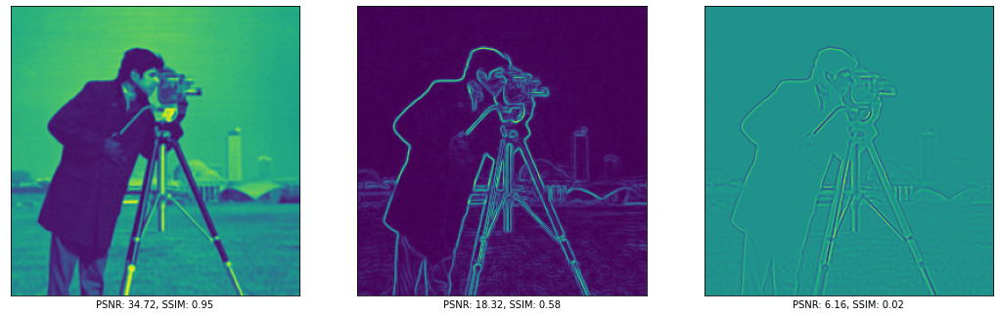

Ground truth


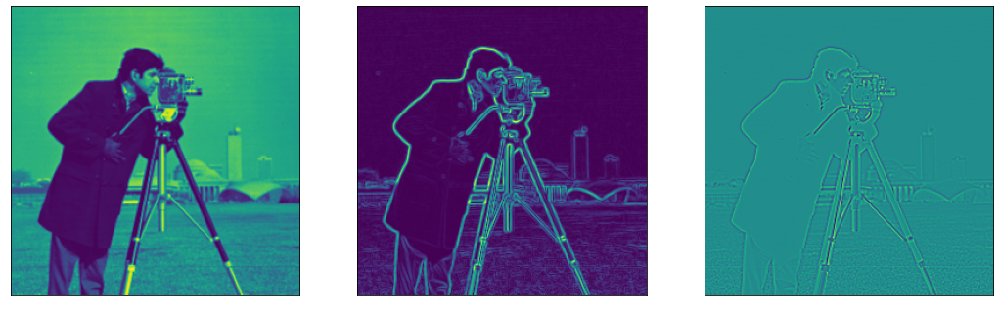

In [ ]:
# Create the network
net_type = 'siren'
training = 'on_image'
net = Siren(n_hidden_layers=HIDDEN_LAYERS, hidden_features=256) # IMPORTANT: 3 layers to compare with SIREN paper results
model = net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output, coords = model(model_input)    
    loss = loss_functions.image_mse(model_output, coords, gt['img'])
    psnr = myutils.psnr(model_output, gt['img'])
    psnrs.append(psnr)
    ssim = myutils.ssim(model_output, gt['img'])
    ssims.append(ssim)

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            img = model_output.clone()
            img_grads = myutils.gradient(model_output, coords)
            img_laplacian = myutils.laplace(model_output, coords)

            img_dict = {
                'img' : img,
                'grads' : img_grads,
                'laplace' : img_laplacian
            }
            if step == total_steps:
                fname = net_type + '_' + str(HIDDEN_LAYERS) + '_layers_' + str(total_steps) + '_' + training + '_' + str(sidelength) + '.png'
                myutils.plot_all(img_dict, gt, sidelength=sidelength, save=True, fname=fname)
            else:
                myutils.plot_all(img_dict, gt, sidelength=sidelength)

    optim.zero_grad()
    loss.backward()
    optim.step()

print('Ground truth')
myutils.plot_all(gt, gt, sidelength=sidelength)

siren_image = {key: value.cpu().detach() for key, value in img_dict.items()}
psnr_siren_image = psnrs
ssims_siren_image = ssims

###2.2 - Poisson image reconstruction

#####2.2.1 - Prepare data

In [ ]:
dataset = PoissonEqn(sidelength, img_type='starfish')
dataloader = DataLoader(dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(dataloader))
gt['grads'] *= 10
gt['laplace'] *= 1e4
gt_starfish = gt
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

#####2.2.2 - Train on gradient

Step 0, Total loss 1535.177002
GPU Memory occupation: 4.4 / 14.8 GB
Step 500, Total loss 4.217752
GPU Memory occupation: 4.4 / 14.8 GB


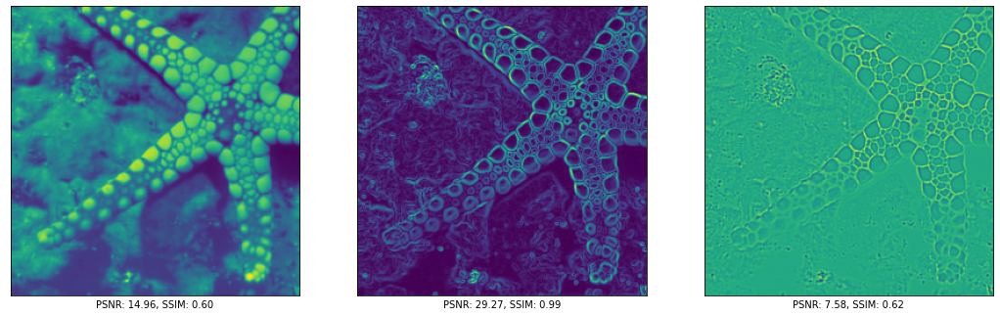

Ground truth


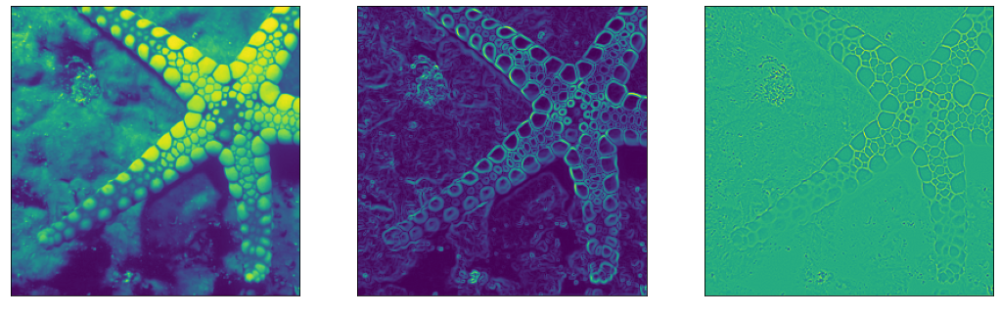

In [ ]:
# Create the network
net_type = 'siren'
training = 'on_gradient'
net = Siren(n_hidden_layers=HIDDEN_LAYERS, hidden_features=256) # IMPORTANT: 3 layers to compare with SIREN paper results
model = net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output, coords = model(model_input)    
    loss = loss_functions.gradients_mse(model_output, coords, gt['grads'])
    # psnr = myutils.psnr(model_output, gt['img'])
    # psnrs.append(psnr)
    # ssim = myutils.ssim(model_output, gt['img'])
    # ssims.append(ssim)

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))

        if verbose or step == total_steps:
            img = model_output.clone()
            img_grads = myutils.gradient(model_output, coords)
            img_laplacian = myutils.laplace(model_output, coords)

            img_dict = {
                'img' : img,
                'grads' : img_grads,
                'laplace' : img_laplacian
            }
            if step == total_steps:
                fname = net_type + '_' + str(HIDDEN_LAYERS) + '_layers_' + str(total_steps) + '_' + training + '_' + str(sidelength) + '.png'
                myutils.plot_all(img_dict, gt, sidelength=sidelength, save=True, fname=fname)
            else:
                myutils.plot_all(img_dict, gt, sidelength=sidelength)

    optim.zero_grad()
    loss.backward()
    optim.step()

print('Ground truth')
myutils.plot_all(gt, gt, sidelength=sidelength)

siren_grad = {key: value.cpu().detach() for key, value in img_dict.items()}
psnr_siren_grad = psnrs
ssims_siren_grad = ssims

#####2.2.3 - Train on laplacian

Step 0, Total loss 4545499.000000
GPU Memory occupation: 6.7 / 14.8 GB
Step 500, Total loss 60707.332031
GPU Memory occupation: 6.7 / 14.8 GB


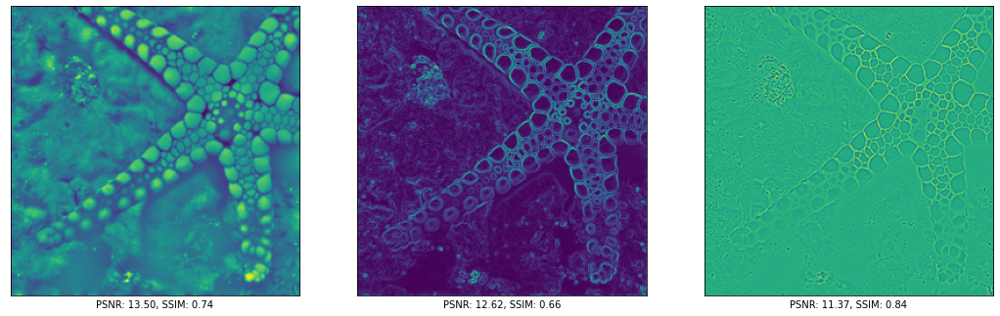

Ground truth


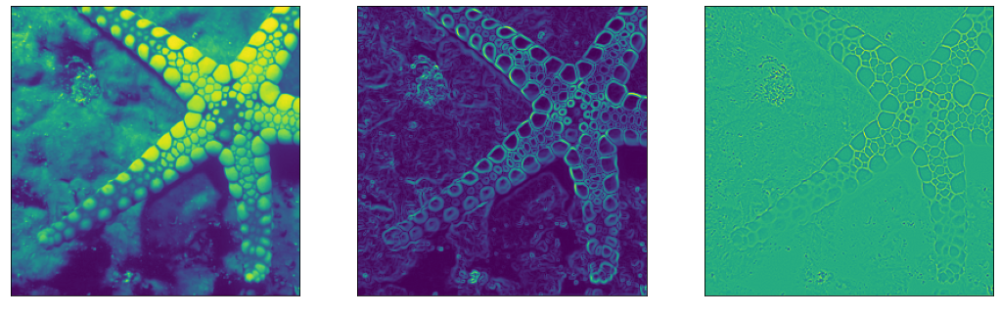

In [ ]:
# Create the network
net_type = 'siren'
training = 'on_laplace'
net = Siren(n_hidden_layers=HIDDEN_LAYERS, hidden_features=256) # IMPORTANT: 3 layers to compare with SIREN paper results
model = net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output, coords = model(model_input)    
    loss = loss_functions.laplace_mse(model_output, coords, gt['laplace'])
    # psnr = myutils.psnr(model_output, gt['img'])
    # psnrs.append(psnr)
    # ssim = myutils.ssim(model_output, gt['img'])
    # ssims.append(ssim)

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        if verbose or step == total_steps:
            img = model_output.clone()
            img_grads = myutils.gradient(model_output, coords)
            img_laplacian = myutils.laplace(model_output, coords)

            img_dict = {
                'img' : img,
                'grads' : img_grads,
                'laplace' : img_laplacian
            }
            if step == total_steps:
                fname = net_type + '_' + str(HIDDEN_LAYERS) + '_layers_' + str(total_steps) + '_' + training + '_' + str(sidelength) + '.png'
                myutils.plot_all(img_dict, gt, sidelength=sidelength, save=True, fname=fname)
            else:
                myutils.plot_all(img_dict, gt, sidelength=sidelength)

    optim.zero_grad()
    loss.backward()
    optim.step()


print('Ground truth')
myutils.plot_all(gt, gt, sidelength=sidelength)

siren_lapl = {key: value.cpu().detach() for key, value in img_dict.items()}
psnr_siren_lapl = psnrs
ssims_siren_lapl = ssims

#3 - Compare with ReLU

###3.1 - Prepare data

In [ ]:
dataset = PoissonEqn(sidelength)
dataloader = DataLoader(dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(dataloader))
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

###3.2 - Train on image

Step 0, Total loss 1.734413
GPU Memory occupation: 0.2 / 14.8 GB
Step 500, Total loss 0.063128
GPU Memory occupation: 0.2 / 14.8 GB


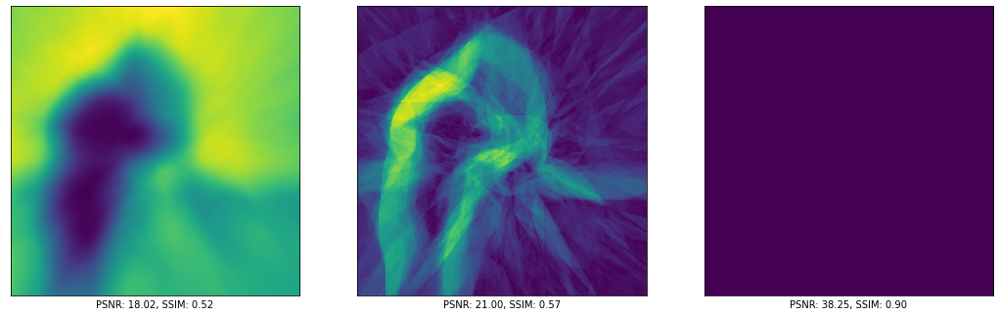

Ground truth


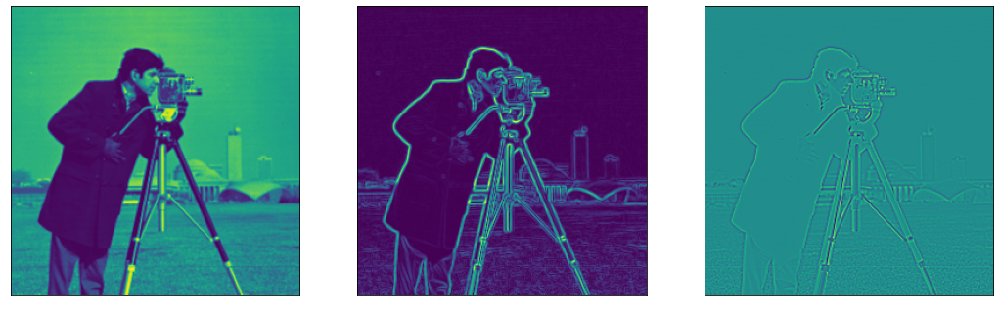

In [ ]:
# Create the network
net_type = 'relu'
training = 'on_image'
net = Relu(n_hidden_layers=HIDDEN_LAYERS, hidden_features=256) # IMPORTANT: 3 layers to compare with SIREN paper results
model = net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output, coords = model(model_input)    
    loss = loss_functions.image_mse(model_output, coords, gt['img'])
    psnr = myutils.psnr(model_output, gt['img'])
    psnrs.append(psnr)
    ssim = myutils.ssim(model_output, gt['img'])
    ssims.append(ssim)

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            img = model_output.clone()
            img_grads = myutils.gradient(model_output, coords)
            img_laplacian = myutils.laplace(model_output, coords)

            img_dict = {
                'img' : img,
                'grads' : img_grads,
                'laplace' : img_laplacian
            }
            if step == total_steps:
                fname = net_type + '_' + str(HIDDEN_LAYERS) + '_layers_' + str(total_steps) + '_' + training + '_' + str(sidelength) + '.png'
                myutils.plot_all(img_dict, gt, sidelength=sidelength, save=True, fname=fname)
            else:
                myutils.plot_all(img_dict, gt, sidelength=sidelength)

    optim.zero_grad()
    loss.backward()
    optim.step()

print('Ground truth')
myutils.plot_all(gt, gt, sidelength=sidelength)

relu_image = {key: value.cpu().detach() for key, value in img_dict.items()}
psnr_relu_image = psnrs
ssims_relu_image = ssims

###3.3 - Prepare data

In [ ]:
dataset = PoissonEqn(sidelength, img_type='starfish')
dataloader = DataLoader(dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(dataloader))
gt['grads'] *= 10
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

###3.4 - Train on gradient

Step 0, Total loss 1540.136108
GPU Memory occupation: 1.1 / 14.8 GB
Step 500, Total loss 1457.429565
GPU Memory occupation: 1.1 / 14.8 GB


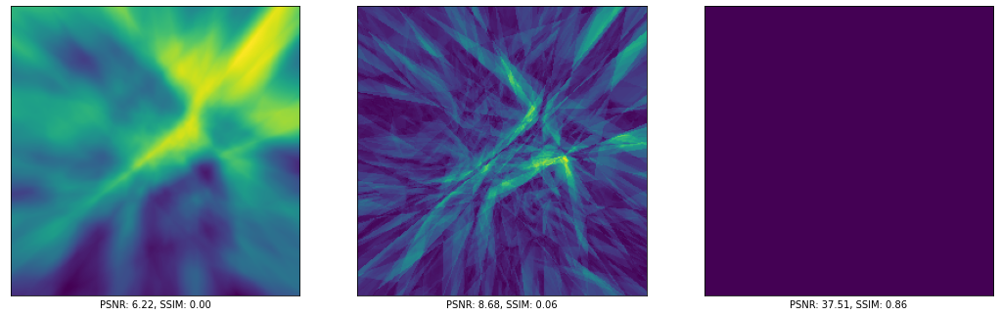

Ground truth


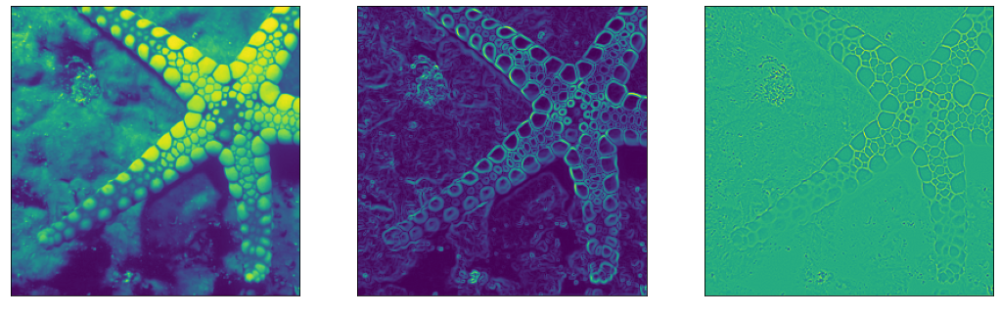

In [ ]:
# Create the network
net_type = 'relu'
training = 'on_gradient'
net = Relu(n_hidden_layers=HIDDEN_LAYERS, hidden_features=256) # IMPORTANT: 3 layers to compare with SIREN paper results
model = net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output, coords = model(model_input)    
    loss = loss_functions.gradients_mse(model_output, coords, gt['grads'])
    # psnr = myutils.psnr(model_output, gt['img'])
    # psnrs.append(psnr)
    # ssim = myutils.ssim(model_output, gt['img'])
    # ssims.append(ssim)

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))

        if verbose or step == total_steps:
            img = model_output.clone()
            img_grads = myutils.gradient(model_output, coords)
            img_laplacian = myutils.laplace(model_output, coords)

            img_dict = {
                'img' : img,
                'grads' : img_grads,
                'laplace' : img_laplacian
            }
            if step == total_steps:
                fname = net_type + '_' + str(HIDDEN_LAYERS) + '_layers_' + str(total_steps) + '_' + training + '_' + str(sidelength) + '.png'
                myutils.plot_all(img_dict, gt, sidelength=sidelength, save=True, fname=fname)
            else:
                myutils.plot_all(img_dict, gt, sidelength=sidelength)

    optim.zero_grad()
    loss.backward()
    optim.step()

print('Ground truth')
myutils.plot_all(gt, gt, sidelength=sidelength)

relu_grad = {key: value.cpu().detach() for key, value in img_dict.items()}
psnr_relu_grad = psnrs
ssims_relu_grad = ssims

#Collect and compare results

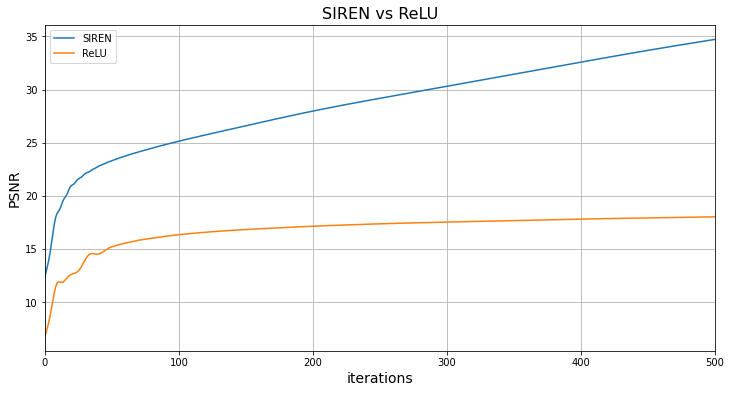

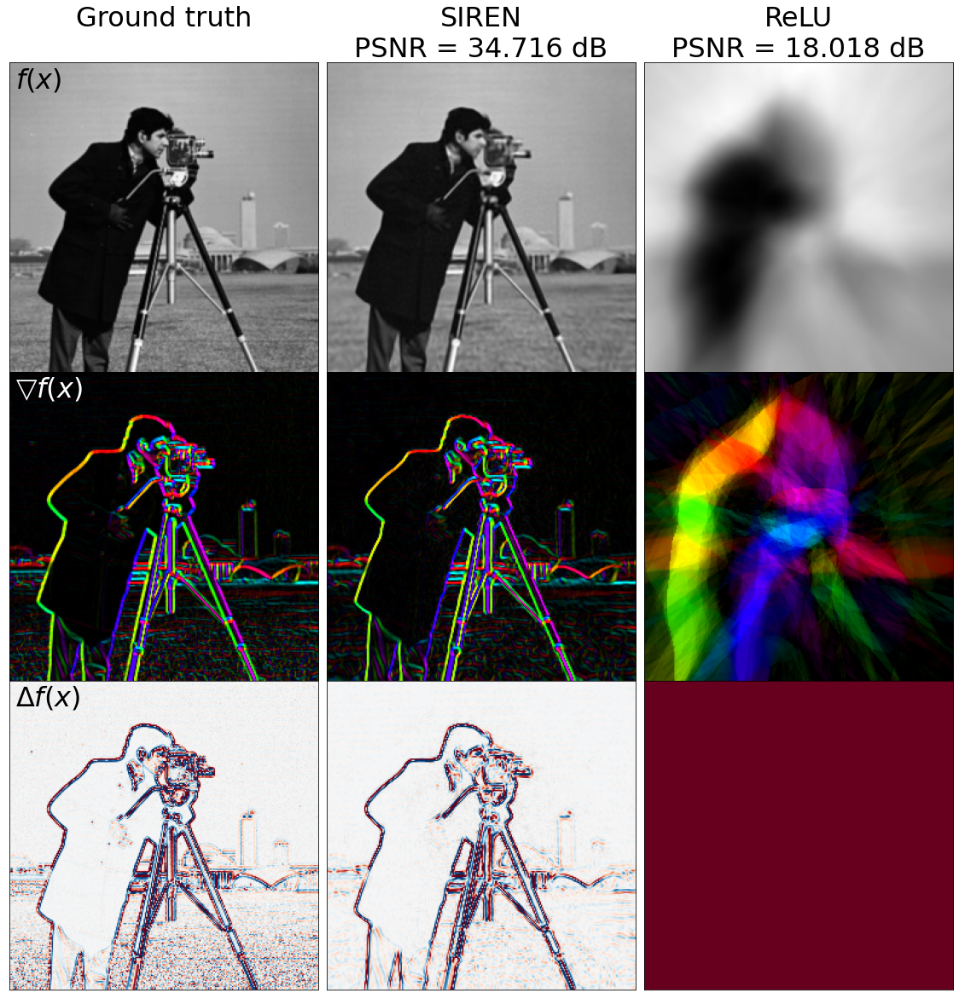

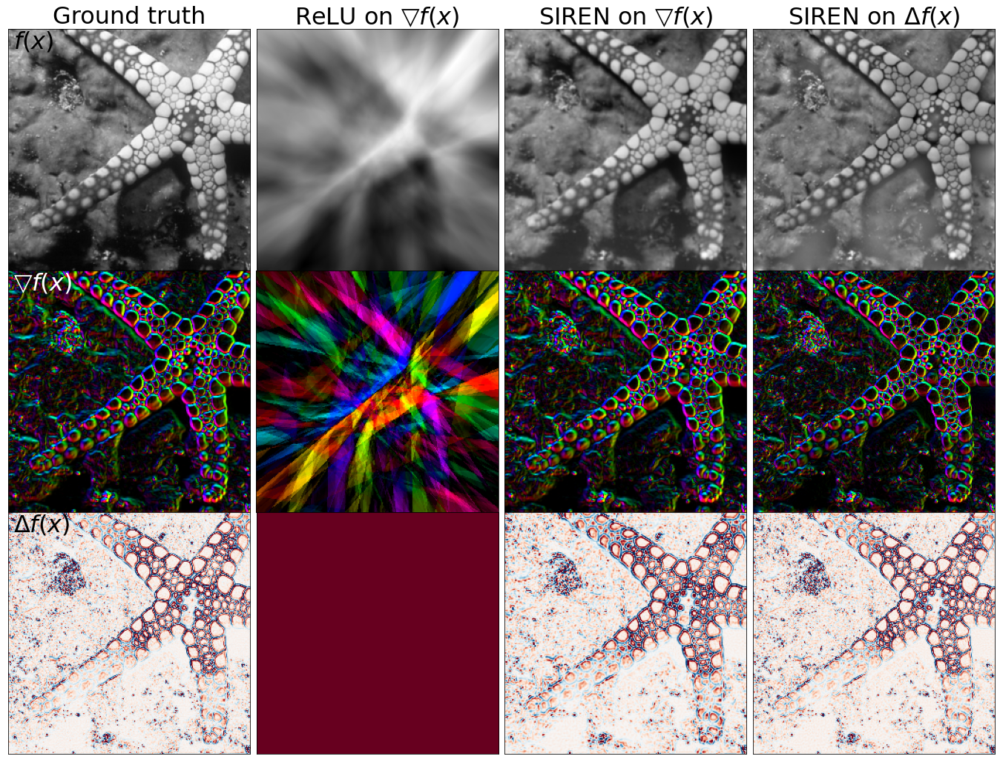

In [ ]:
# SIREN vs ReLU PSNR
psnr_data = {'SIREN' : psnr_siren_image, 'ReLU' : psnr_relu_image}
myutils.plot_psnrs(psnr_data, TOTAL_STEPS, 'SIREN vs ReLU', save=True, fname='psnr_siren_vs_relu_2_layers_15000_on_image_256.png')

# (GT, SIREN, ReLU) x (image, gradient, laplace)
myutils.print_fitting_grid(gt_cameraman, siren_image, relu_image, psnr_siren_image[-1], psnr_relu_image[-1], sidelength=sidelength)

# (GT, GRAD(ReLU), GRAD(SIREN), LAPL(SIREN)) x (image, gradient, laplace)
myutils.print_poisson_grid(gt_starfish, relu_grad, siren_grad, siren_lapl, sidelength=sidelength)

#4 - Ablation studies

###4.1 - Weights initialization

####4.1.1 - change weights of the first layer

#####4.1.1.1 - Prepare data

In [ ]:
dataset = PoissonEqn(256, gradients=True, laplace=True)
dataloader = DataLoader(dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(dataloader))
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

#####4.1.1.2 - PSNR evaluation

standard weights
Step 0, Total loss 0.247763
Step 500, Total loss 0.000841
Step 1000, Total loss 0.000228


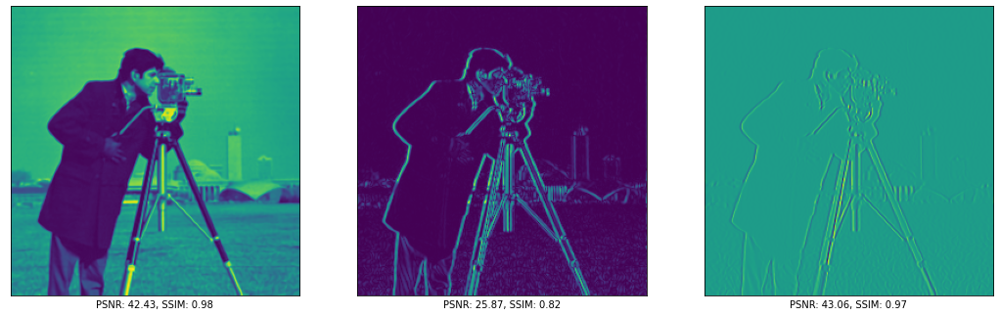

Kaiming Uniform
Step 0, Total loss 0.229857
Step 500, Total loss 0.000146
Step 1000, Total loss 0.000046


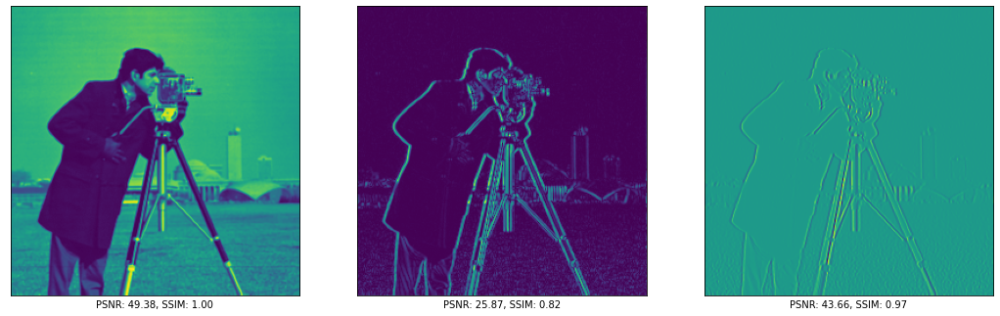

Kaiming Normal
Step 0, Total loss 0.229314
Step 500, Total loss 0.000162
Step 1000, Total loss 0.000049


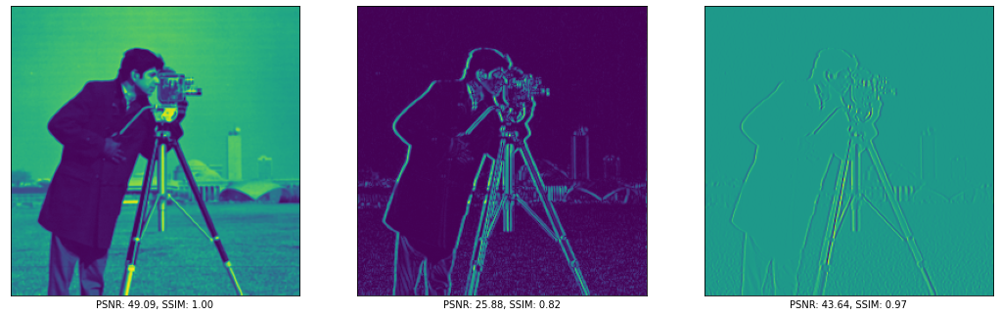

Uniform
Step 0, Total loss 0.236322
Step 500, Total loss 0.000584
Step 1000, Total loss 0.000152


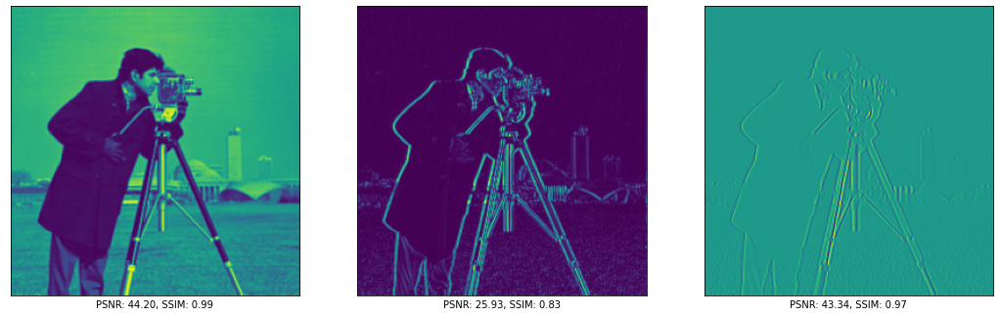

Normal
Step 0, Total loss 0.238243
Step 500, Total loss 0.000178
Step 1000, Total loss 0.000055


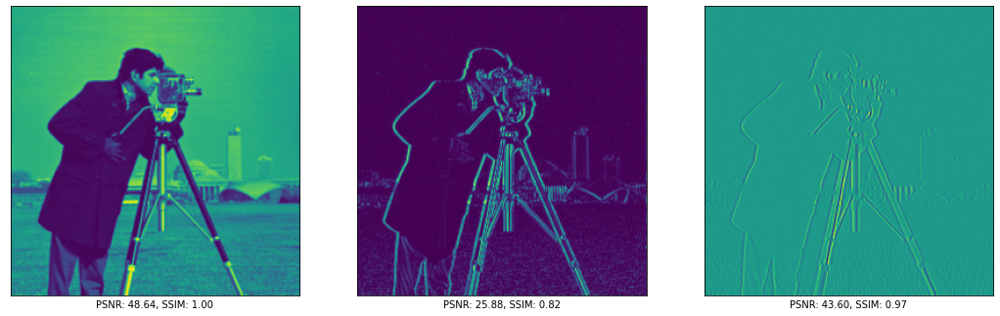

Xavier Uniform
Step 0, Total loss 0.232883
Step 500, Total loss 0.001981
Step 1000, Total loss 0.000720


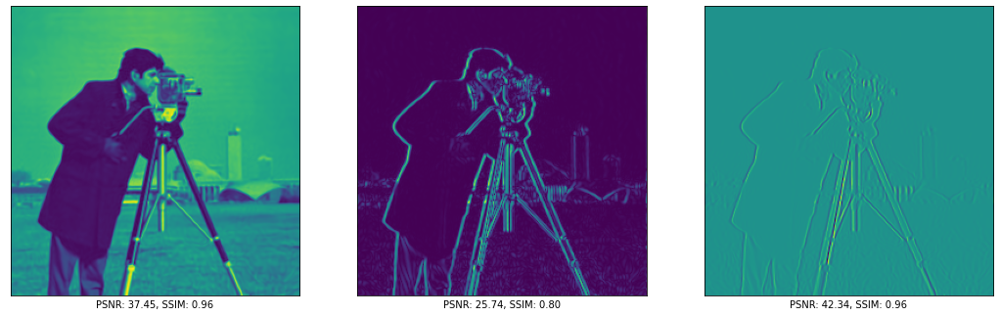

Xavier Normal
Step 0, Total loss 0.239899
Step 500, Total loss 0.002356
Step 1000, Total loss 0.000916


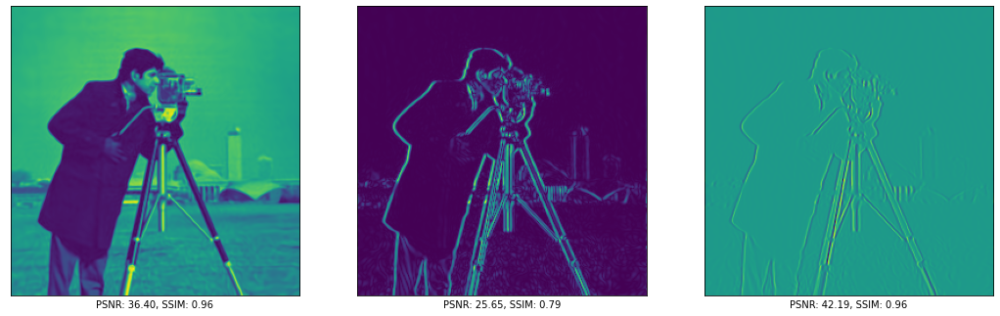

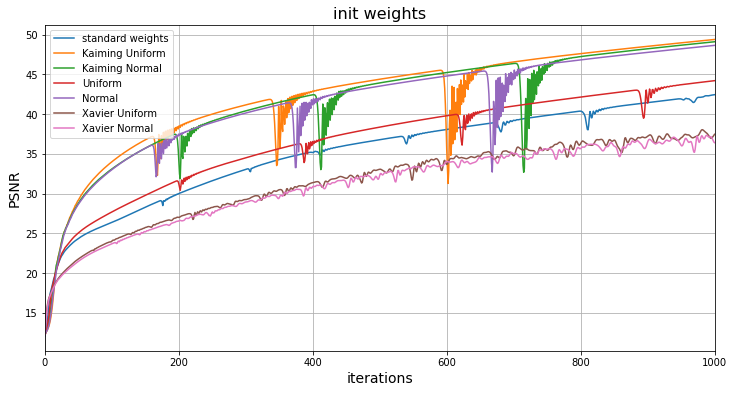

In [ ]:
psnr_data = {}

net_type = 'siren'

# Weight initialization of first layer
init_weights = [[None, "standard weights"],
                [partial(init.kaiming_uniform_, a=0.0, nonlinearity='relu', mode='fan_in'), "Kaiming Uniform"],
                [partial(init.kaiming_normal_, a=0.0, nonlinearity='relu', mode='fan_in'), "Kaiming Normal"],
                [partial(init.uniform_, a=0.0, b=1.0), "Uniform"],
                [partial(init.normal_, mean=0.0, std=1.0), "Normal"],
                [partial(init.xavier_uniform_, gain=1.0), "Xavier Uniform"],
                [partial(init.xavier_normal_, gain=1.0), "Xavier Normal"]
                ]

for weights in init_weights:
    print(weights[1])
    psnrs = []
    
    net = Siren(n_hidden_layers=3, hidden_features=256)
    
    if weights[0] is not None:
        weights[0](net.net[0].linear.weight)

    model = net.cuda()

    # Define optimizer
    optim = torch.optim.Adam(lr=1e-4, params=model.parameters())

    total_steps = 1000
    steps_til_summary = STEPS_TIL_SUMMARY
    verbose = VERBOSE # True, False

    for step in range(total_steps+1):
        model_output, coords = model(model_input)    
        loss = loss_functions.image_mse(model_output, coords, gt['img'])
        psnr = myutils.psnr(model_output, gt['img'])
        psnrs.append(psnr)
        if not step % steps_til_summary:
            print("Step %d, Total loss %0.6f" % (step, loss))
            if verbose or step == total_steps:
                img = model_output.clone()
                img_grads = myutils.sobel_filter(model_output.clone())
                img_laplacian = myutils.laplace_filter(model_output.clone())

                img_dict = {
                    'img' : img,
                    'grads' : img_grads,
                    'laplace' : img_laplacian
                }
                if step == total_steps:
                    fname = net_type + '_' + str(HIDDEN_LAYERS) + '_layers_' + str(total_steps) + '_' + weights[1] + '_' + str(sidelength) + '.png'
                    myutils.plot_all(img_dict, gt, sidelength=sidelength, save=True, fname=fname)
                else:
                    myutils.plot_all(img_dict, gt, sidelength=sidelength)

        optim.zero_grad()
        loss.backward()
        optim.step()

    psnr_data[weights[1]] = psnrs

myutils.plot_psnrs(psnr_data, total_steps, 'init weights', save=True, fname='psnr_siren_2_layers_2000_256_first_layer_initialization.png')

#####4.1.1.3 - Layer activation evaluation

/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))


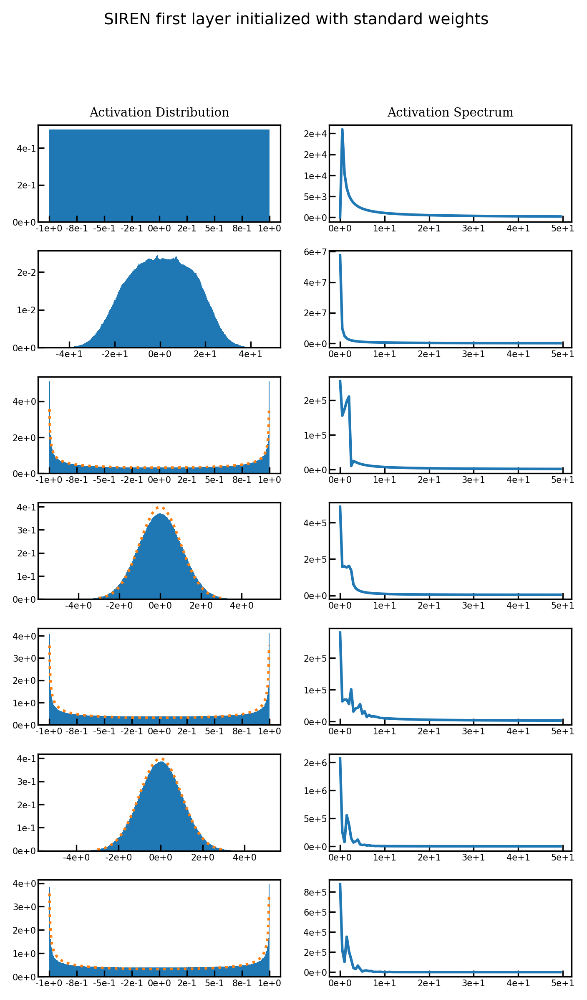

In [ ]:
# Distribution configuration
distribution = None
# distribution = [partial(init.kaiming_uniform_, a=0.0, nonlinearity='relu', mode='fan_in'), "Kaiming Uniform"]
# distribution = [partial(init.kaiming_normal_, a=0.0, nonlinearity='relu', mode='fan_in'), "Kaiming Normal"]
# distribution = [partial(init.uniform_, a=0.0), "Uniform"]
# distribution = [partial(init.normal_, mean=0.0), "Normal"]
# distribution = [partial(init.xavier_uniform_, gain=1.0), "Xavier Uniform"]
# distribution = [partial(init.xavier_normal_, gain=1.0), "Xavier Normal"]

model = Siren(n_hidden_layers=HIDDEN_LAYERS, outermost_linear=True, with_activations=True) # with_activation = True so that the number of features is automatically set
if distribution is not None:
  distribution[0](model.net[0].linear.weight)
  title = "SIREN first layer initialized with " + distribution[1]
else:
  title = "SIREN first layer initialized with standard weights"
model = model.cuda()
activations = model.forward_with_activations(model_input) # Calling forward with activation in order to return activation to plot
myutils.plot_all_activations_and_grads(activations, title=title)

####4.1.2 - change weights of the hidden layers

#####4.1.2.1 - Prepare data

In [ ]:
dataset = PoissonEqn(256, gradients=True, laplace=True)
dataloader = DataLoader(dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(dataloader))
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

#####4.1.2.2 - PSNR evaluation

standard weights
Step 0, Total loss 0.245713
Step 500, Total loss 0.000784
Step 1000, Total loss 0.000190


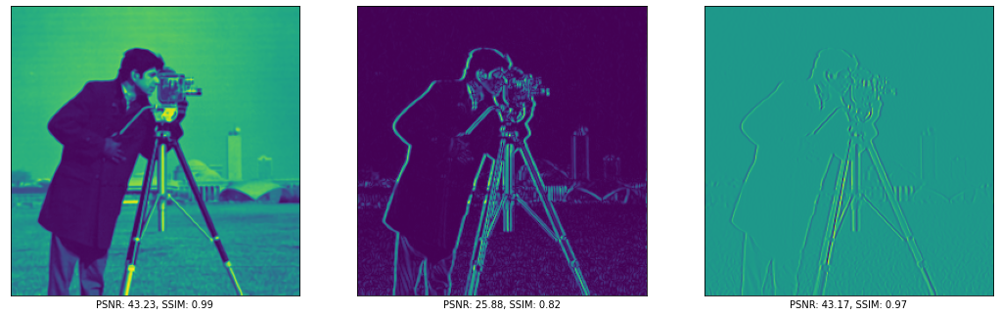

Uniform
Step 0, Total loss 0.233321
Step 500, Total loss 0.229239
Step 1000, Total loss 0.228900


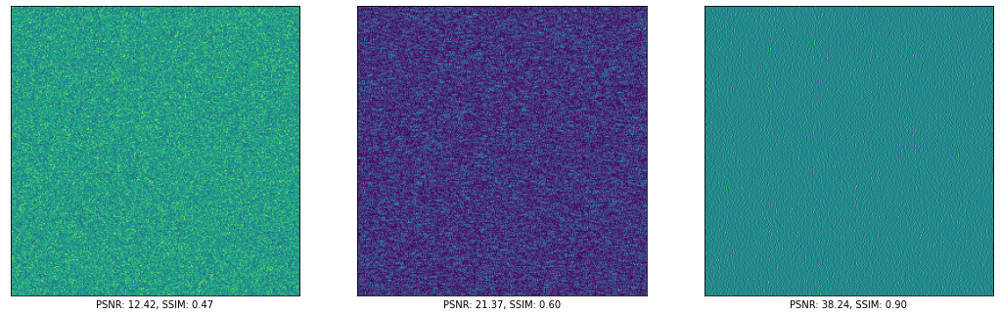

Normal
Step 0, Total loss 0.245712
Step 500, Total loss 0.235234
Step 1000, Total loss 0.230924


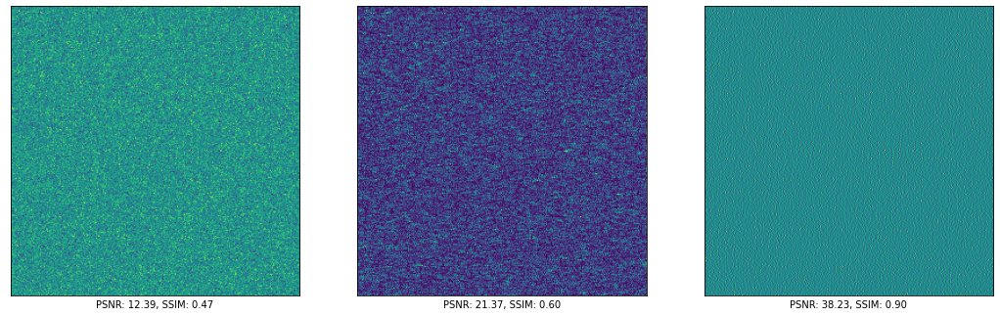

Kaiming Uniform
Step 0, Total loss 0.234730
Step 500, Total loss 0.229629
Step 1000, Total loss 0.228923


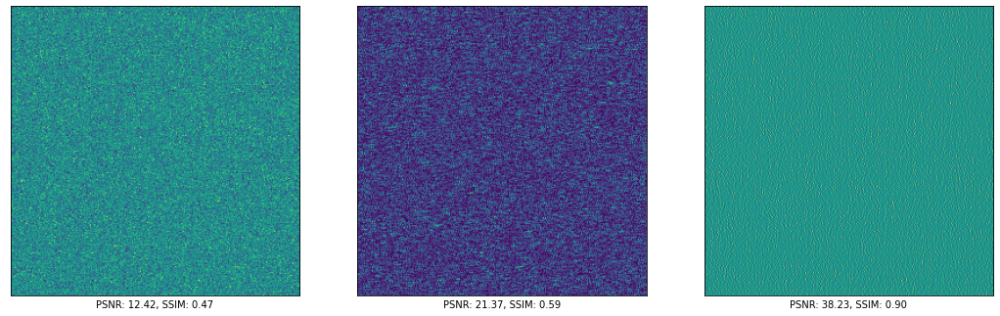

Kaiming Normal
Step 0, Total loss 0.237632
Step 500, Total loss 0.230876
Step 1000, Total loss 0.229245


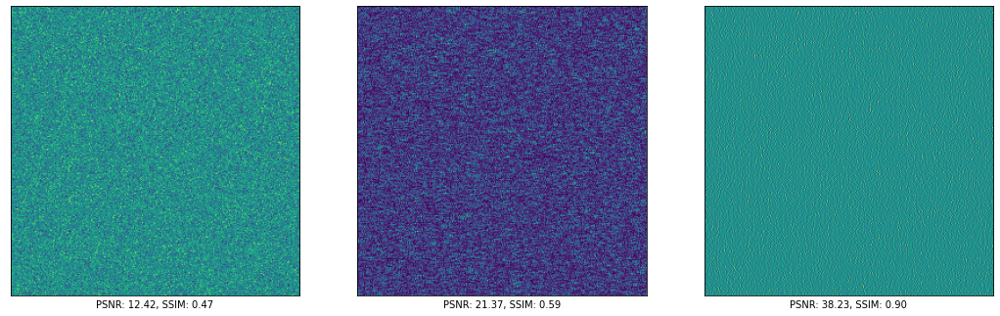

Xavier Uniform
Step 0, Total loss 0.231936
Step 500, Total loss 0.228960
Step 1000, Total loss 0.228894


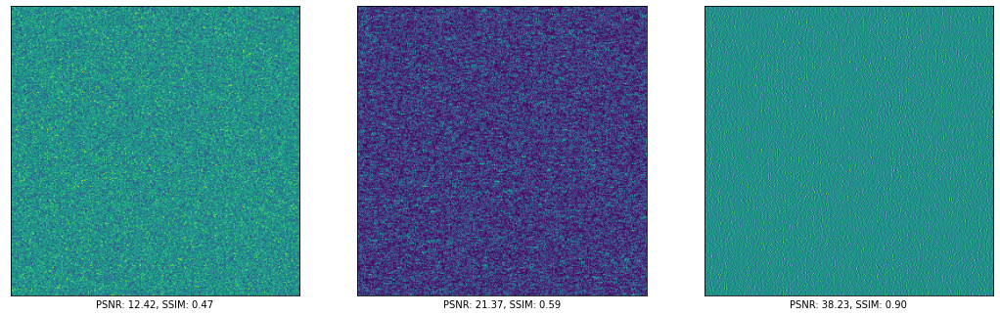

Xavier Normal
Step 0, Total loss 0.243061
Step 500, Total loss 0.233798
Step 1000, Total loss 0.230284


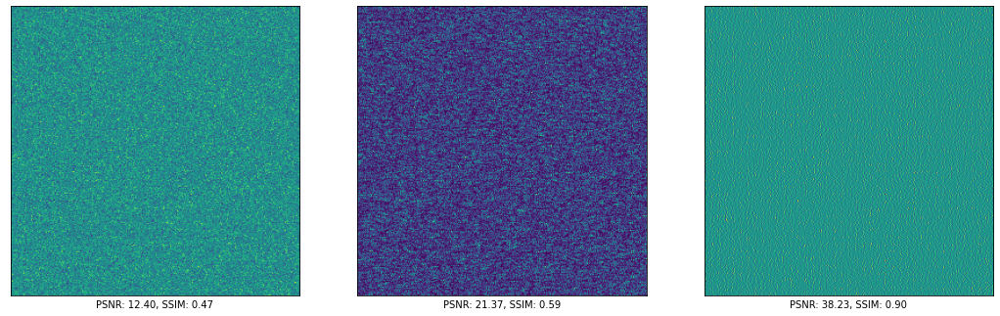

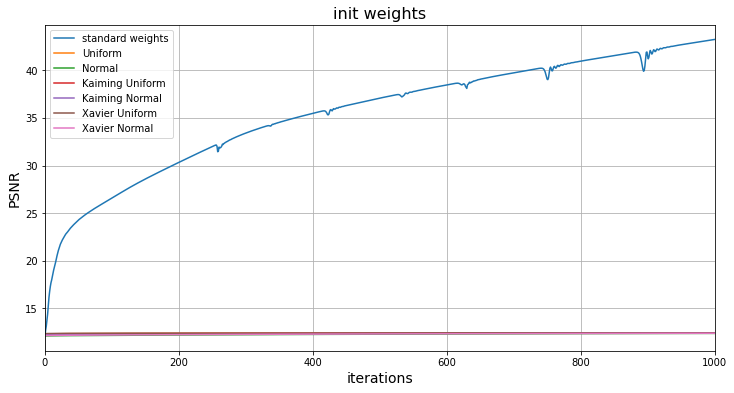

In [ ]:
psnr_data = {}

net_type = 'siren'
layers = 3

# Weight initialization of first layer
init_weights = [[None, "standard weights"],
                [partial(init.uniform_), "Uniform"],
                [partial(init.normal_), "Normal"],
                [partial(init.kaiming_uniform_, a=0.0, nonlinearity='relu', mode='fan_in'), "Kaiming Uniform"],
                [partial(init.kaiming_normal_, a=0.0, nonlinearity='relu', mode='fan_in'), "Kaiming Normal"],
                [partial(init.xavier_uniform_, gain=1.0), "Xavier Uniform"],
                [partial(init.xavier_normal_, gain=1.0), "Xavier Normal"]
                ]

for weights in init_weights:
    print(weights[1])
    psnrs = []
    
    net = Siren(n_hidden_layers=layers, hidden_features=256)

    if weights[0] is not None:
        for l in range(1, layers+1):
            weights[0](net.net[l].linear.weight)

    model = net.cuda()

    # Define optimizer
    optim = torch.optim.Adam(lr=1e-4, params=model.parameters())

    total_steps = 1000
    steps_til_summary = STEPS_TIL_SUMMARY
    verbose = VERBOSE # True, False

    for step in range(total_steps+1):
        model_output, coords = model(model_input)    
        loss = loss_functions.image_mse(model_output, coords, gt['img'])
        psnr = myutils.psnr(model_output, gt['img'])
        psnrs.append(psnr)
        if not step % steps_til_summary:
            print("Step %d, Total loss %0.6f" % (step, loss))
            if verbose or step == total_steps:
                img = model_output.clone()
                img_grads = myutils.sobel_filter(model_output.clone())
                img_laplacian = myutils.laplace_filter(model_output.clone())

                img_dict = {
                    'img' : img,
                    'grads' : img_grads,
                    'laplace' : img_laplacian
                }
                if step == total_steps:
                    fname = net_type + '_' + str(HIDDEN_LAYERS) + '_layers_' + str(total_steps) + '_' + weights[1] + '_' + str(sidelength) + '.png'
                    myutils.plot_all(img_dict, gt, sidelength=sidelength, save=True, fname=fname)
                else:
                    myutils.plot_all(img_dict, gt, sidelength=sidelength)

        optim.zero_grad()
        loss.backward()
        optim.step()

    psnr_data[weights[1]] = psnrs

myutils.plot_psnrs(psnr_data, total_steps, 'init weights', save=True, fname='psnr_siren_2_layers_1000_256_hidden_layer_initialization.png')

#####4.1.2.3 - Layer activation evaluation

/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))


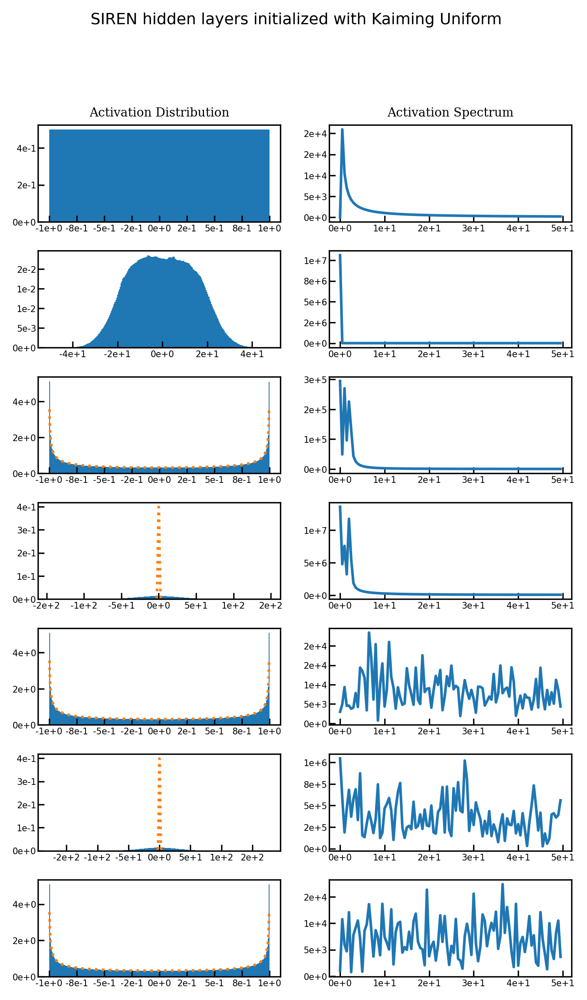

In [ ]:
# Distribution configuration
# distribution = None
distribution = [partial(init.kaiming_uniform_, a=0.0, nonlinearity='relu', mode='fan_in'), "Kaiming Uniform"]
# distribution = [partial(init.kaiming_normal_, a=0.0, nonlinearity='relu', mode='fan_in'), "Kaiming Normal"]
# distribution = [partial(init.uniform_, a=0.0), "Uniform"]
# distribution = [partial(init.normal_, mean=0.0), "Normal"]
# distribution = [partial(init.xavier_uniform_, gain=1.0), "Xavier Uniform"]
# distribution = [partial(init.xavier_normal_, gain=1.0), "Xavier Normal"]

model = Siren(n_hidden_layers=HIDDEN_LAYERS, outermost_linear=True, with_activations=True) # with_activation = True so that the number of features is automatically set
if distribution is not None:
  for l in range(1, HIDDEN_LAYERS+1):
    distribution[0](model.net[l].linear.weight)
  title = "SIREN hidden layers initialized with " + distribution[1]
else:
  title = "SIREN hidden layers initialized with standard weights"
model = model.cuda()
activations = model.forward_with_activations(model_input) # Calling forward with activation in order to return activation to plot
myutils.plot_all_activations_and_grads(activations, title=title)

###4.2 - ω0 initialization 

#####4.2.1 - Prepare data

In [ ]:
dataset = PoissonEqn(sidelength)
dataloader = DataLoader(dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(dataloader))
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

#####4.2.2 - change ω0 in first layer

w0: 8
Step 0, Total loss 0.229941
Step 100, Total loss 0.026559
Step 200, Total loss 0.014269
Step 300, Total loss 0.009281
Step 400, Total loss 0.006685
Step 500, Total loss 0.005075
Step 600, Total loss 0.004066
Step 700, Total loss 0.003479
Step 800, Total loss 0.002969
Step 900, Total loss 0.002669
Step 1000, Total loss 0.002238
w0: 15
Step 0, Total loss 0.243609
Step 100, Total loss 0.018936
Step 200, Total loss 0.010540
Step 300, Total loss 0.006121
Step 400, Total loss 0.003769
Step 500, Total loss 0.002464
Step 600, Total loss 0.001762
Step 700, Total loss 0.001315
Step 800, Total loss 0.001099
Step 900, Total loss 0.000921
Step 1000, Total loss 0.000774
w0: 30
Step 0, Total loss 0.228878
Step 100, Total loss 0.011897
Step 200, Total loss 0.005798
Step 300, Total loss 0.003141
Step 400, Total loss 0.001763
Step 500, Total loss 0.001069
Step 600, Total loss 0.000716
Step 700, Total loss 0.000516
Step 800, Total loss 0.000391
Step 900, Total loss 0.000308
Step 1000, Total loss 0.

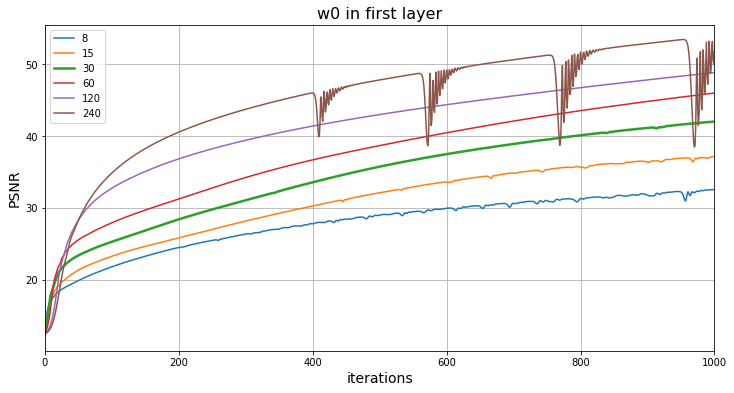

In [ ]:
psnr_data = {}
first_omega_0 = [
                 8,
                 15,
                 30,
                 60,
                 120,
                 240
                ]

for w0 in first_omega_0:
    print("w0:", w0)
    # Create the network
    net = Siren(n_hidden_layers=HIDDEN_LAYERS, hidden_features=256, first_omega_0=w0, hidden_omega_0=30)
    model = net.cuda()

    # Define optimizer
    optim = torch.optim.Adam(lr=1e-4, params=model.parameters())
    total_steps = 1000
    steps_til_summary = 100

    psnrs = []

    for step in range(total_steps+1):
        model_output, coords = model(model_input)    
        loss = loss_functions.image_mse(model_output, coords, gt['img'])
        psnr = myutils.psnr(model_output, gt['img'])
        psnrs.append(psnr)
        if not step % steps_til_summary:
            print("Step %d, Total loss %0.6f" % (step, loss))

        optim.zero_grad()
        loss.backward()
        optim.step()

    psnr_data[str(w0)] = psnrs

myutils.plot_psnrs(psnr_data, total_steps, 'w0 in first layer', save=True, fname='psnr_w0_first_layer_1000_10_layers.png')

#####4.2.3 - change ω0 in hidden layers

w0: 8
Step 0, Total loss 0.244598
Step 100, Total loss 0.023051
Step 200, Total loss 0.016437
Step 300, Total loss 0.012393
Step 400, Total loss 0.009201
Step 500, Total loss 0.006654
Step 600, Total loss 0.004862
Step 700, Total loss 0.003634
Step 800, Total loss 0.002789
Step 900, Total loss 0.002204
Step 1000, Total loss 0.001786
w0: 15
Step 0, Total loss 0.251692
Step 100, Total loss 0.018005
Step 200, Total loss 0.011490
Step 300, Total loss 0.007560
Step 400, Total loss 0.004875
Step 500, Total loss 0.003088
Step 600, Total loss 0.001990
Step 700, Total loss 0.001385
Step 800, Total loss 0.001027
Step 900, Total loss 0.000813
Step 1000, Total loss 0.000658
w0: 30
Step 0, Total loss 0.238952
Step 100, Total loss 0.012838
Step 200, Total loss 0.006760
Step 300, Total loss 0.004066
Step 400, Total loss 0.002482
Step 500, Total loss 0.001511
Step 600, Total loss 0.000980
Step 700, Total loss 0.000691
Step 800, Total loss 0.000515
Step 900, Total loss 0.000397
Step 1000, Total loss 0.

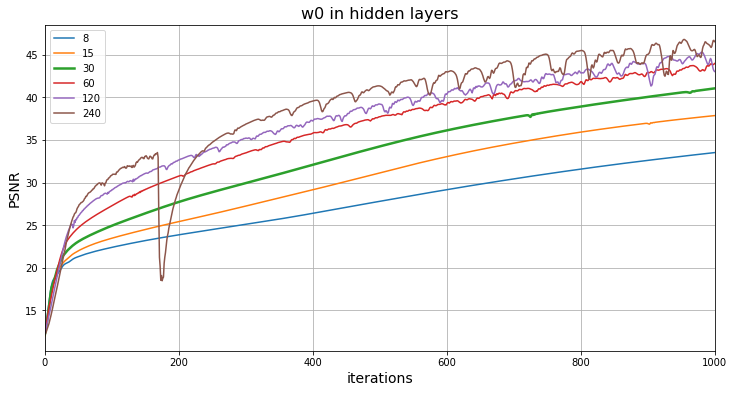

In [ ]:
psnr_data = {}
hidden_omega_0 = [
                  8,
                  15,
                  30,
                  60,
                  120,
                  240
                  ]

for w0 in hidden_omega_0:
    print("w0:", w0)
    # Create the network
    net = Siren(n_hidden_layers=HIDDEN_LAYERS, hidden_features=256, first_omega_0=30, hidden_omega_0=w0)
    model = net.cuda()

    # Define optimizer
    optim = torch.optim.Adam(lr=1e-4, params=model.parameters())
    total_steps = 1000
    steps_til_summary = 100

    psnrs = []

    for step in range(total_steps+1):
        model_output, coords = model(model_input)    
        loss = loss_functions.image_mse(model_output, coords, gt['img'])
        psnr = myutils.psnr(model_output, gt['img'])
        psnrs.append(psnr)
        if not step % steps_til_summary:
            print("Step %d, Total loss %0.6f" % (step, loss))

        optim.zero_grad()
        loss.backward()
        optim.step()

    psnr_data[str(w0)] = psnrs

myutils.plot_psnrs(psnr_data, total_steps, 'w0 in hidden layers', save=True, fname='psnr_w0_hidden_layers_1000_2_layers.png')

#####4.2.4 - change ω0 in all the layers

w0: 8
Step 0, Total loss 0.233193
Step 100, Total loss 0.053533
Step 200, Total loss 0.038983
Step 300, Total loss 0.028139
Step 400, Total loss 0.021744
Step 500, Total loss 0.017772
Step 600, Total loss 0.015240
Step 700, Total loss 0.013454
Step 800, Total loss 0.011939
Step 900, Total loss 0.010582
Step 1000, Total loss 0.009397
w0: 15
Step 0, Total loss 0.239066
Step 100, Total loss 0.027340
Step 200, Total loss 0.016664
Step 300, Total loss 0.010832
Step 400, Total loss 0.007169
Step 500, Total loss 0.004699
Step 600, Total loss 0.003342
Step 700, Total loss 0.002577
Step 800, Total loss 0.002094
Step 900, Total loss 0.001775
Step 1000, Total loss 0.001562
w0: 30
Step 0, Total loss 0.235122
Step 100, Total loss 0.011824
Step 200, Total loss 0.006019
Step 300, Total loss 0.003266
Step 400, Total loss 0.001774
Step 500, Total loss 0.001036
Step 600, Total loss 0.000689
Step 700, Total loss 0.000494
Step 800, Total loss 0.000377
Step 900, Total loss 0.000306
Step 1000, Total loss 0.

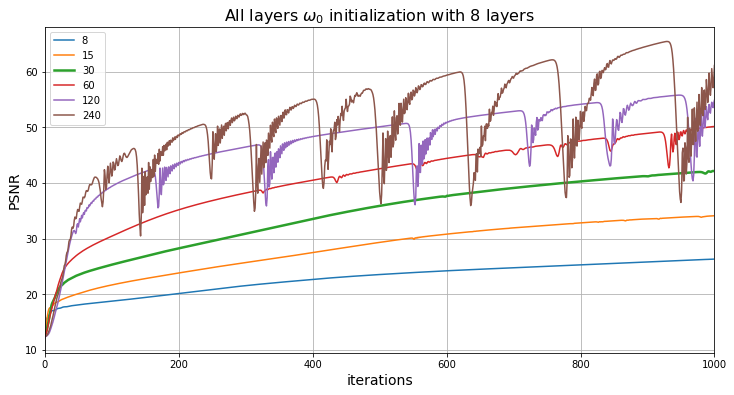

In [ ]:
psnr_data = {}
omega_0 = [
          8,
          15,
          30,
          60,
          120,
          240
          ]

for w0 in omega_0:
    print("w0:", w0)
    # Create the network
    net = Siren(n_hidden_layers=HIDDEN_LAYERS, hidden_features=256, first_omega_0=w0, hidden_omega_0=w0)
    model = net.cuda()

    # Define optimizer
    optim = torch.optim.Adam(lr=1e-4, params=model.parameters())
    total_steps = 1000
    steps_til_summary = 100

    psnrs = []

    for step in range(total_steps+1):
        model_output, coords = model(model_input)    
        loss = loss_functions.image_mse(model_output, coords, gt['img'])
        psnr = myutils.psnr(model_output, gt['img'])
        psnrs.append(psnr)
        if not step % steps_til_summary:
            print("Step %d, Total loss %0.6f" % (step, loss))

        optim.zero_grad()
        loss.backward()
        optim.step()

    psnr_data[str(w0)] = psnrs

myutils.plot_psnrs(psnr_data, total_steps, 'All layers $ω_0$ initialization with 8 layers', save=True, fname='psnr_w0_all_layers_1000_8_layers.png')

# 5 - SISR

### 5.1 - Define SISR config

In [ ]:
import box
import PIL
from torchvision.utils import save_image
from torchvision.transforms import Resize, Compose, ToPILImage, ToTensor, Normalize
from PIL import Image

subsets = {
    # 'bicubic_x2' : 'all',
    # 'unknown_x2' : 'all',
    # 'bicubic_x3' : 'all',
    # 'unknown_x3' : 'all',
    # 'bicubic_x4' : 'all',
    # 'unknown_x4' : 'all',
    # 'bicubic_x8' : 'all',
    # 'mild_x4' : 'all',
    # 'difficult_x4' : 'all',
    # 'wild_x4' : 'all',
    'HR_images' : 'train',
    }

# max cameramen image = 512x512
# max starfish image = 481x321
# 224: avoid VVG loss interpolation
lr_sidelength = 128 # 128, 224
hr_sidelength = 512 # 256, 512

dataset_type = 'skimage' # skimage, div2k

# Choose image type for skimage
img_type = 'cameraman' # cameraman, starfish

# Choose index for DIV2K
div2k_index = 28

# Config the network
LR = 1e-4
HIDDEN_LAYERS = 3 # 2, 3, 5, 10
HIDDEN_FEATURES = 256 # 256, 512
VERBOSE = False
TOTAL_STEPS = 500 # 500, 1000
STEPS_TIL_SUMMARY = TOTAL_STEPS*0.1

idx_recommended = [
    2,      # palma
    21,     # paesaggio
    28,     # affreschi
    33,     # carrozza
    49,     # quadro contemporaneo
    51,     # città
    68,     # donna
    82,     # paesaggio con fiume
    89,     # uomo
    109,    # asiatici
    143,    # auto
    159,    # verdura
    177,    # cammelli
    181,    # tempio
]
idx_to_sample = [div2k_index] # only the first one will be considered

### 5.2 - Prepare Dataset and Dataloader

In [ ]:
if dataset_type == 'skimage':
    lr_dataset = PoissonEqn(lr_sidelength, img_type=img_type, gradients=False, laplace=False)
    hr_dataset = PoissonEqn(hr_sidelength, img_type=img_type, gradients=False, laplace=False)
elif dataset_type == 'div2k':
    if not os.path.isdir('data/DIV2K'):
        DIV2K_loader.DIV2KImport(sets=subsets)
    lr_dataset = DIV2KImageDataset(subsets=subsets, sidelength=lr_sidelength ,transform=default_transform(lr_sidelength), idx_to_sample=idx_to_sample, with_coords=True)
    hr_dataset = DIV2KImageDataset(subsets=subsets, sidelength=hr_sidelength, transform=default_transform(hr_sidelength), idx_to_sample=idx_to_sample, with_coords=True)
else:
    raise Exception('Unexpected dataset type') 

lr_dataloader = DataLoader(lr_dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(lr_dataloader))
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

hr_dataloader = DataLoader(hr_dataset, batch_size=1, pin_memory=True, num_workers=0)

hr_grid, hr_gt = next(iter(hr_dataloader))
gt_sisr = hr_gt['img']
gt_lr_sisr = gt['img']
hr_gt = {key: value.cuda() for key, value in hr_gt.items()}
hr_grid = hr_grid.cuda()

### 5.3 - Classic SIREN

Step 0, Total loss 0.208300
GPU Memory occupation: 7.1 / 14.8 GB
Step 50, Total loss 0.000846
GPU Memory occupation: 7.1 / 14.8 GB
Step 100, Total loss 0.000107
GPU Memory occupation: 7.1 / 14.8 GB
Step 150, Total loss 0.000026
GPU Memory occupation: 7.1 / 14.8 GB
Step 200, Total loss 0.000009
GPU Memory occupation: 7.1 / 14.8 GB
Step 250, Total loss 0.000004
GPU Memory occupation: 7.1 / 14.8 GB
Step 300, Total loss 0.000002
GPU Memory occupation: 7.1 / 14.8 GB
Step 350, Total loss 0.000001
GPU Memory occupation: 7.1 / 14.8 GB
Step 400, Total loss 0.000001
GPU Memory occupation: 7.1 / 14.8 GB
Step 450, Total loss 0.000001
GPU Memory occupation: 7.1 / 14.8 GB
Step 500, Total loss 0.000000
GPU Memory occupation: 7.1 / 14.8 GB


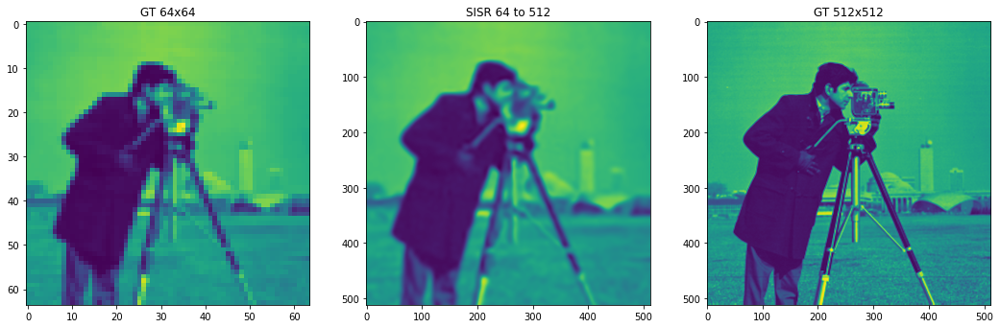

PSNR: 22.68167506676106
SSIM: 0.7043534927382807


In [ ]:
# Create the network
siren_net = Siren(n_hidden_layers=HIDDEN_LAYERS, hidden_features=HIDDEN_FEATURES)
model = siren_net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output, coords = model(model_input)
    # SISR
    hr_img, _ = model(hr_grid)
    loss = loss_functions.image_mse(model_output, coords, gt['img'])

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
siren_sisr = hr_img.cpu().detach()
psnrs_siren_sisr = psnrs
ssims_siren_sisr = ssims
psnr_siren_sisr = psnrs[-1]
ssim_siren_sisr = ssims[-1]

print('PSNR:', psnr_siren_sisr)
print('SSIM:', ssim_siren_sisr)

### 5.4 - SIREN with VGG loss

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth



Step 0, Total loss 55.641449
GPU Memory occupation: 7.5 / 14.8 GB
Step 50, Total loss 0.087241
GPU Memory occupation: 7.7 / 14.8 GB
Step 100, Total loss 0.004554
GPU Memory occupation: 7.7 / 14.8 GB
Step 150, Total loss 0.000948
GPU Memory occupation: 7.7 / 14.8 GB
Step 200, Total loss 0.000368
GPU Memory occupation: 7.7 / 14.8 GB
Step 250, Total loss 0.000175
GPU Memory occupation: 7.7 / 14.8 GB
Step 300, Total loss 0.000092
GPU Memory occupation: 7.7 / 14.8 GB
Step 350, Total loss 0.000053
GPU Memory occupation: 7.7 / 14.8 GB
Step 400, Total loss 0.000034
GPU Memory occupation: 7.7 / 14.8 GB
Step 450, Total loss 0.000023
GPU Memory occupation: 7.7 / 14.8 GB
Step 500, Total loss 0.000028
GPU Memory occupation: 7.7 / 14.8 GB


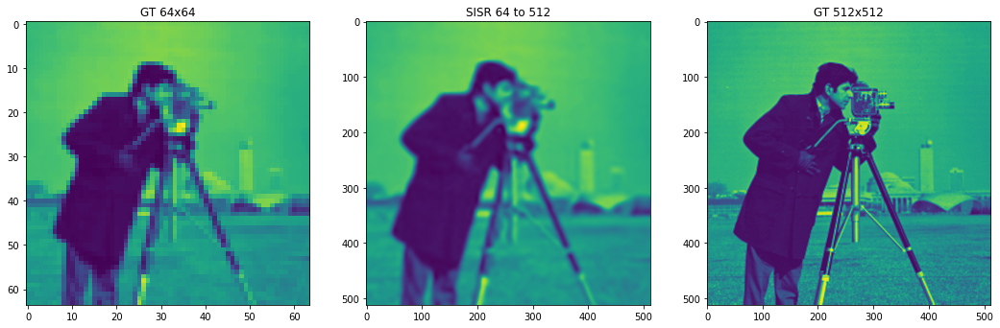

PSNR: 22.64982573578387
SSIM: 0.7044249549963321


In [ ]:
input = {
    'coords' : model_input,
    'gt' : gt['img'],
    'sidelength' : lr_sidelength
}
hr_input = {
    'coords' : hr_grid,
    'gt' : hr_gt['img'],
    'sidelength' : hr_sidelength
}

# Create the network
siren_net = Siren(n_hidden_layers=HIDDEN_LAYERS, hidden_features=HIDDEN_FEATURES, with_vgg_loss=True)
# siren_net.vgg_loss.resize = False
model = siren_net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output, coords, loss = model(input)
    hr_img, _, _ = model(hr_input)

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
siren_vgg_sisr = hr_img.cpu().detach()
psnrs_siren_vgg_sisr = psnrs
ssims_siren_vgg_sisr = ssims
psnr_siren_vgg_sisr = psnrs[-1]
ssim_siren_vgg_sisr = ssims[-1]

print('PSNR:', psnr_siren_vgg_sisr)
print('SSIM:', ssim_siren_vgg_sisr)

### 5.5 - SIREN with P.E.

SingleBVPNet(
  (positional_encoding): PosEncodingNeRF()
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=18, out_features=512, bias=True)
        (1): Sine()
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): Sine()
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): Sine()
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): Sine()
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 0.216409
GPU Memory occupation: 7.1 / 14.8 GB
Step 50, Total loss 0.000141
GPU Memory occupation: 7.1 / 14.8 GB
Step 100, Total loss 0.000001
GPU Memory occupation: 7.1 / 14.8 GB
Step 150, Total loss 0.000000
GPU Mem

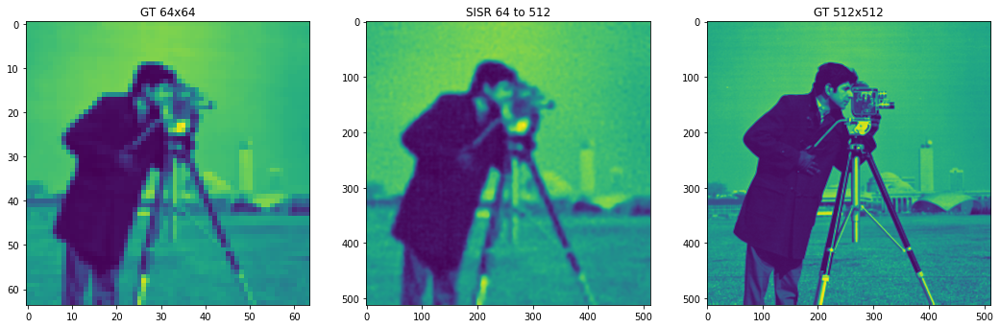

PSNR: 22.47958072253965
SSIM: 0.6759137235843379


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
siren_net = modules.SingleBVPNet(type='sine', mode='nerf', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = siren_net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']
    loss = loss_functions.image_mse(model_output, coords, gt['img'])

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
siren_nerf_sisr = hr_img.cpu().detach()
psnrs_siren_nerf_sisr = psnrs
ssims_siren_nerf_sisr = ssims
psnr_siren_nerf_sisr = psnrs[-1]
ssim_siren_nerf_sisr = ssims[-1]

print('PSNR:', psnr_siren_nerf_sisr)
print('SSIM:', ssim_siren_nerf_sisr)

### 5.6 - SIREN with P.E. and VGG loss

SingleBVPNet(
  (positional_encoding): PosEncodingNeRF()
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=18, out_features=512, bias=True)
        (1): Sine()
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): Sine()
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): Sine()
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): Sine()
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 56.971481
GPU Memory occupation: 7.4 / 14.8 GB
Step 50, Total loss 0.518273
GPU Memory occupation: 7.4 / 14.8 GB
Step 100, Total loss 0.199468
GPU Memory occupation: 7.4 / 14.8 GB
Step 150, Total loss 0.127985
GPU Me

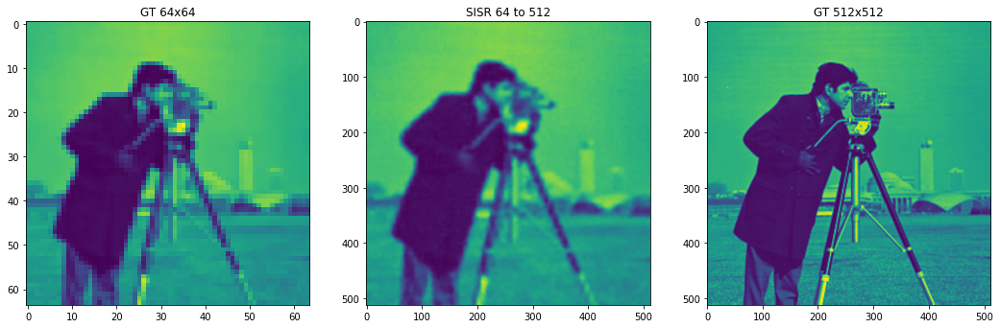

PSNR: 22.53533716606089
SSIM: 0.6930558428366793


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
siren_net = modules.SingleBVPNet(type='sine', mode='nerf', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = siren_net.cuda()

loss_fn = loss_functions.VGGPerceptualLoss().cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']

    # Adapt images for VGG
    _y = model_output.view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    _gt = gt['img'].view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    loss = loss_fn(_y, _gt)

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
siren_nerf_vgg_sisr = hr_img.cpu().detach()
psnrs_siren_nerf_vgg_sisr = psnrs
ssims_siren_nerf_vgg_sisr = ssims
psnr_siren_nerf_vgg_sisr = psnrs[-1]
ssim_siren_nerf_vgg_sisr = ssims[-1]

print('PSNR:', psnr_siren_nerf_vgg_sisr)
print('SSIM:', ssim_siren_nerf_vgg_sisr)

### 5.7 - ReLU with P.E.

SingleBVPNet(
  (positional_encoding): PosEncodingNeRF()
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=18, out_features=512, bias=True)
        (1): ReLU(inplace=True)
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): ReLU(inplace=True)
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): ReLU(inplace=True)
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=512, bias=True)
        (1): ReLU(inplace=True)
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=512, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 1.662616
GPU Memory occupation: 5.3 / 14.8 GB
Step 50, Total loss 0.044660
GPU Memory occupation: 5.3 / 14.8 GB
Step 100, Total loss 0.019516
GPU Memory occupation: 5.3

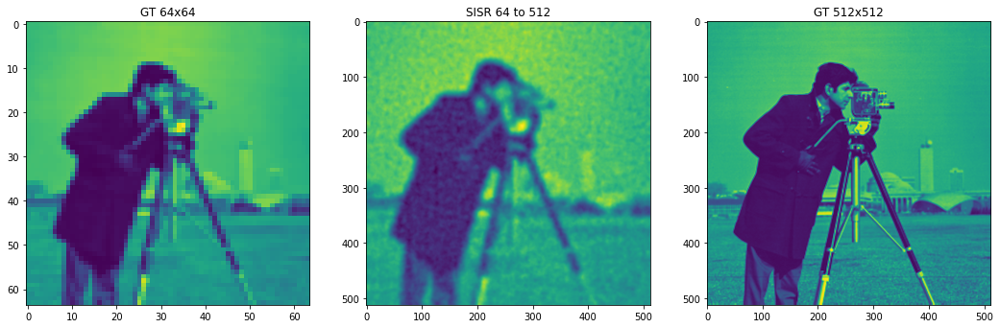

PSNR: 21.65411818633876
SSIM: 0.5802192629345836


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
relu_net = modules.SingleBVPNet(type='relu', mode='nerf', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = relu_net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']
    loss = loss_functions.image_mse(model_output, coords, gt['img'])

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
relu_sisr = hr_img.cpu().detach()
psnrs_relu_sisr = psnrs
ssims_relu_sisr = ssims
psnr_relu_sisr = psnrs[-1]
ssim_relu_sisr = ssims[-1]

print('PSNR:', psnr_relu_sisr)
print('SSIM:', ssim_relu_sisr)

### 5.8 - Bicubic

/usr/local/lib/python3.6/dist-packages/torchvision/transforms/functional.py:92: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.from_numpy(np.array(pic, np.float32, copy=False))


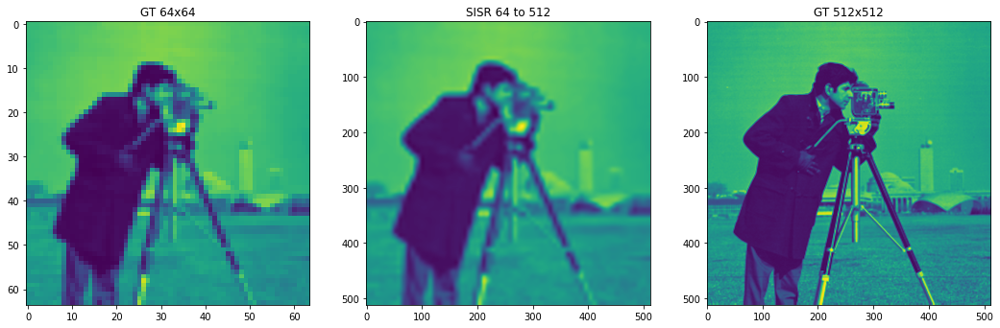

PSNR: 22.874623921793965
SSIM: 0.7031572953482282


In [ ]:
to_hr = Compose([
    Resize(hr_sidelength, Image.BICUBIC),
    ToTensor()
])

bicubic_input = gt['img'].clone().cpu().detach().view(lr_sidelength, lr_sidelength).numpy()
bicubic_input = ToPILImage()(bicubic_input)

hr_img = to_hr(bicubic_input) # SISR

_, axes = plt.subplots(1, 3, figsize=(18,6))
axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
plt.show()

bicubic_sisr = hr_img.cpu().detach()

psnr_bicubic_sisr = myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength)
ssim_bicubic_sisr = myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength)

psnrs_bicubic_sisr = [psnr_bicubic_sisr for i in range(TOTAL_STEPS+1)]
ssims_bicubic_sisr = [ssim_bicubic_sisr for i in range(TOTAL_STEPS+1)]

print('PSNR:', psnr_bicubic_sisr)
print('SSIM:', ssim_bicubic_sisr)

### 5.9 - SRGAN

rm: cannot remove '/content/mydataset': No such file or directory
Dataset [BicubicDownDataset] is created.
Number of test images in [mydataset]: 32
Dataset [BicubicDownDataset] is created.
Number of test images in [mydataset]: 32
/content/SRGAN-PyTorch/models/modules/block.py:150: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
  nn.init.kaiming_normal(self.C.weight, a=a, mode='fan_in')
loading model for G [/content/siren/src/srgan/latest_G.pth] ...
---------- Model initialized -------------
Model [SRResNetTestModel] is created.
Start Testing ...
Testing [mydataset]...

Test set: [mydataset]

/content/SRGAN-PyTorch/models/sr_resnet_test_model.py:35: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  self.real_H = Variable(self.input_H, volatile=volatile) # in range [0,1]
/content/SRGAN-PyTorch/models/sr_resnet_test_model.py:36: UserWarning: volatile was removed and now has no effect. Use `with torch

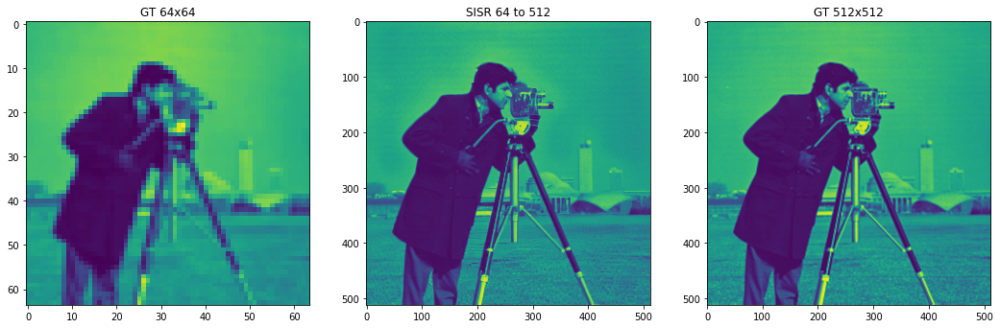

PSNR: 24.672834078562374
SSIM: 0.7704001926165551


In [ ]:
!rm -r '/content/mydataset'
os.mkdir('/content/mydataset')
os.mkdir('/content/mydataset/mydataset')
os.mkdir('/content/mydataset/mydataset/data')
os.mkdir('/content/mydataset/mydataset/data/images')
os.mkdir('/content/mydataset/mydataset/data/images/train')
os.mkdir('/content/mydataset/mydataset/data/groundTruth')
os.mkdir('/content/mydataset/mydataset/data/groundTruth/train')

image = hr_gt['img'].clone().cpu().detach().view(hr_sidelength, hr_sidelength)
image = (image +1) /2.

name = 'test_img'
fname = name + '.png'

save_image(image, '/content/mydataset/mydataset/data/groundTruth/train/' + fname)
save_image(image, '/content/mydataset/mydataset/data/images/train/' + fname)

!CUDA_VISIBLE_DEVICES=0 python ./SRGAN-PyTorch/test.py --option /content/siren/src/srgan/config_test.json

transform = Compose([
    Resize(hr_sidelength),
    ToTensor(),
    Normalize(torch.Tensor([0.5]), torch.Tensor([0.5])) # image = (image - mean) / std, output values in [-1., +1.]
])

srgan_img = Image.open('/content/results/SRGAN_x4/test_images/mydataset/' + name + '/sr.png')
srgan_img = srgan_img.convert('L')
srgan_img = transform(srgan_img)

_, axes = plt.subplots(1, 3, figsize=(18,6))
axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
axes[1].imshow(srgan_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
plt.show()

srgan_sisr = srgan_img

psnr_srgan_sisr = myutils.img_psnr(srgan_img, hr_gt['img'], hr_sidelength)
ssim_srgan_sisr = myutils.img_ssim(srgan_img, hr_gt['img'], hr_sidelength)

psnrs_srgan_sisr = [psnr_srgan_sisr for i in range(TOTAL_STEPS+1)]
ssims_srgan_sisr = [ssim_srgan_sisr for i in range(TOTAL_STEPS+1)]

print('PSNR:', psnr_srgan_sisr)
print('SSIM:', ssim_srgan_sisr)

### 5.10 - Collect and compare results

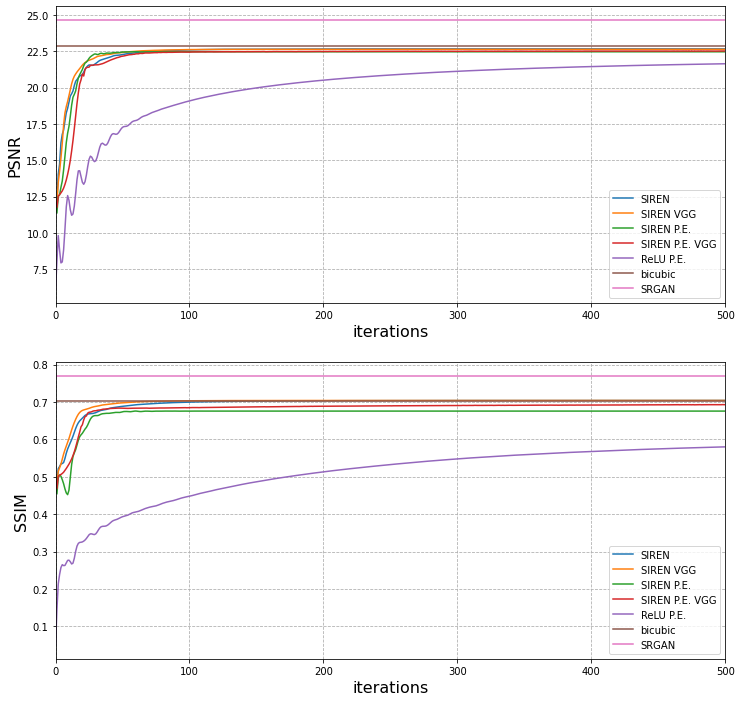

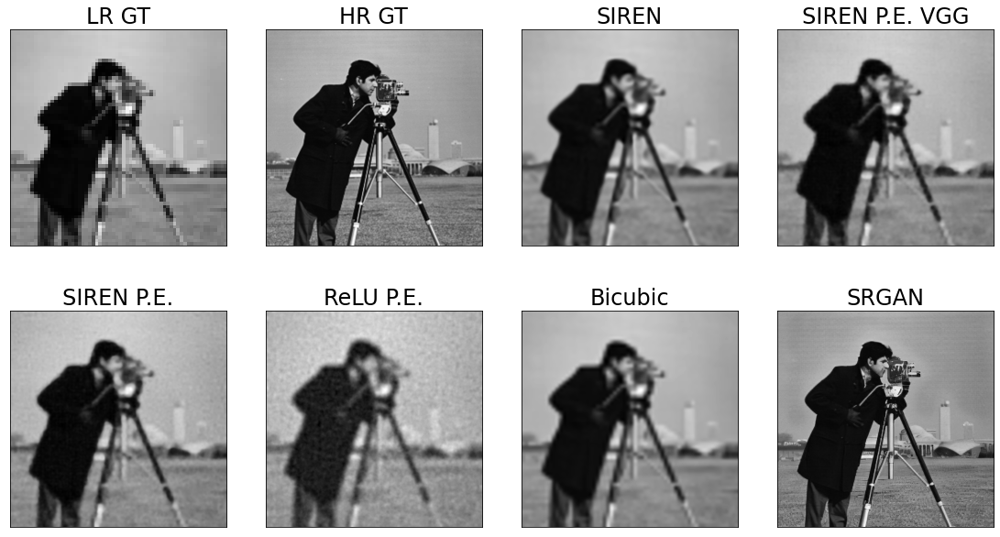

SISR 64x64 to 512x512
hidden layers: 3
hidden features: 512
total steps: 500


PSNR:
	SIREN: 22.681675
	SIREN VGG: 22.649826
	SIREN P.E.: 22.479581
	SIREN P.E. VGG: 22.535337
	ReLU P.E.: 21.654118
	bicubic: 22.874624
	SRGAN: 24.672834


SSIM:
	SIREN: 0.704353
	SIREN VGG: 0.704425
	SIREN P.E.: 0.675914
	SIREN P.E. VGG: 0.693056
	ReLU P.E.: 0.580219
	bicubic: 0.703157
	SRGAN: 0.770400


In [ ]:
psnr_data = {
    'SIREN' : psnrs_siren_sisr,
    'SIREN VGG' : psnrs_siren_vgg_sisr,
    'SIREN P.E.' : psnrs_siren_nerf_sisr,
    'SIREN P.E. VGG' : psnrs_siren_nerf_vgg_sisr,
    'ReLU P.E.' : psnrs_relu_sisr,
    'bicubic' : psnrs_bicubic_sisr,
    'SRGAN' : psnrs_srgan_sisr,
    }
ssim_data = {
    'SIREN' : ssims_siren_sisr,
    'SIREN VGG' : ssims_siren_vgg_sisr,
    'SIREN P.E.' : ssims_siren_nerf_sisr,
    'SIREN P.E. VGG' : ssims_siren_nerf_vgg_sisr,
    'ReLU P.E.' : ssims_relu_sisr,
    'bicubic' : ssims_bicubic_sisr,
    'SRGAN' : ssims_srgan_sisr,
    }

myutils.plot_psnr_and_ssim(psnr_data, ssim_data, total_steps, save=True, fname='psnr_and_ssim_sisr.png')

# images = {
#     'GT' : gt_sisr,
#     'SIREN' : siren_sisr,
#     'SIREN VGG' : siren_vgg_sisr,
#     'SIREN P.E.' : siren_nerf_sisr,
#     # 'SIREN P.E. VGG' : siren_nerf_vgg_sisr,
#     'ReLU P.E.' : relu_sisr,
#     'Bicubic' : bicubic_sisr,
#     'SRGAN' : srgan_sisr,
#     }
images = {
    'LR GT' : gt_lr_sisr,
    'HR GT' : gt_sisr,
    'SIREN' : siren_sisr,
    'SIREN P.E. VGG' : siren_vgg_sisr,
    'SIREN P.E.' : siren_nerf_sisr,
    'SIREN P.E. VGG' : siren_nerf_vgg_sisr,
    'ReLU P.E.' : relu_sisr,
    'Bicubic' : bicubic_sisr,
    'SRGAN' : srgan_sisr,
    }

def print_sisr_grid(images, hr_sidelength=512, lr_sidelength=512, figsize=(20, 10), textsize=24, fname='sisr_grid.png'):
    ''' Create custom figure with grid (GT, SIREN, SIREN VGG, ReLU-Nerf, Bicubic, SRGAN)'''

    fig = plt.figure(constrained_layout=False, figsize=figsize)
    gs = fig.add_gridspec(2, 4, wspace=0, hspace=0.3)

    for i, (key, value) in enumerate(images.items()):
        if i < 4:
            a1 = fig.add_subplot(gs[0, i])
        else:
            a1 = fig.add_subplot(gs[1, i-4])
        if key == 'LR GT':
            a1.imshow(value.cpu().view(lr_sidelength, lr_sidelength).detach().numpy(), cmap='gray')
        else:
            a1.imshow(value.cpu().view(hr_sidelength, hr_sidelength).detach().numpy(), cmap='gray')
        a1.set_xticks([])
        a1.set_yticks([])
        a1.set_title(key, fontsize=textsize)
    plt.savefig(fname=fname, bbox_inches='tight')
    plt.show()

print_sisr_grid(images, hr_sidelength=hr_sidelength, lr_sidelength=lr_sidelength)

# myutils.print_sisr_grid(images, sidelength=hr_sidelength)

print('SISR %dx%d to %dx%d' % (lr_sidelength, lr_sidelength, hr_sidelength, hr_sidelength))
print('hidden layers: %d' % (HIDDEN_LAYERS))
print('hidden features: %d' % (HIDDEN_FEATURES))
print('total steps: %d' % (TOTAL_STEPS))
print('\n')

print('PSNR:')
for key, val in psnr_data.items():
    print('\t' + key + ': %0.6f' % (val[-1]))
print('\n')
print('SSIM:')
for key, val in ssim_data.items():
    print('\t' + key + ': %0.6f' % (val[-1]))

# 6 - Supplementary materials

## 6.1 - Compare ReLU classic, VGG and P.E.

### 6.1.1 - Define config

In [ ]:
import box
import PIL
from torchvision.utils import save_image
from torchvision.transforms import Resize, Compose, ToPILImage, ToTensor, Normalize
from PIL import Image

subsets = {
    # 'bicubic_x2' : 'all',
    # 'unknown_x2' : 'all',
    # 'bicubic_x3' : 'all',
    # 'unknown_x3' : 'all',
    # 'bicubic_x4' : 'all',
    # 'unknown_x4' : 'all',
    # 'bicubic_x8' : 'all',
    # 'mild_x4' : 'all',
    # 'difficult_x4' : 'all',
    # 'wild_x4' : 'all',
    'HR_images' : 'train',
    }

# max cameramen image = 512x512
# max starfish image = 481x321
# 224: avoid VVG loss interpolation
lr_sidelength = 128 # 64, 128, 224, 256
hr_sidelength = 512 # 256, 512

dataset_type = 'div2k' # skimage, div2k

# Choose image type for skimage
img_type = 'cameraman' # cameraman, starfish

# Choose index for DIV2K
div2k_index = 143

# Config the network
LR = 1e-4
HIDDEN_LAYERS = 3 # 2, 3, 5, 10
HIDDEN_FEATURES = 256 # 256. 512
VERBOSE = False
TOTAL_STEPS = 1000 # 500, 1000
STEPS_TIL_SUMMARY = TOTAL_STEPS*0.1

idx_recommended = [
    2,      # palma
    21,     # paesaggio
    28,     # affreschi
    33,     # carrozza
    49,     # quadro contemporaneo
    51,     # città
    68,     # donna
    82,     # paesaggio con fiume
    89,     # uomo
    109,    # asiatici
    143,    # auto
    159,    # verdura
    177,    # cammelli
    181,    # tempio
]
idx_to_sample = [div2k_index] # only the first one will be considered

### 6.1.2 - Prepare Dataset and Dataloader

In [ ]:
if dataset_type == 'skimage':
    lr_dataset = PoissonEqn(lr_sidelength, img_type=img_type, gradients=False, laplace=False)
    hr_dataset = PoissonEqn(hr_sidelength, img_type=img_type, gradients=False, laplace=False)
elif dataset_type == 'div2k':
    if not os.path.isdir('data/DIV2K'):
        DIV2K_loader.DIV2KImport(sets=subsets)
    lr_dataset = DIV2KImageDataset(subsets=subsets, sidelength=lr_sidelength ,transform=default_transform(lr_sidelength), idx_to_sample=idx_to_sample, with_coords=True)
    hr_dataset = DIV2KImageDataset(subsets=subsets, sidelength=hr_sidelength, transform=default_transform(hr_sidelength), idx_to_sample=idx_to_sample, with_coords=True)
else:
    raise Exception('Unexpected dataset type') 

lr_dataloader = DataLoader(lr_dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(lr_dataloader))
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

hr_dataloader = DataLoader(hr_dataset, batch_size=1, pin_memory=True, num_workers=0)

hr_grid, hr_gt = next(iter(hr_dataloader))
gt_sisr = hr_gt['img']
hr_gt = {key: value.cuda() for key, value in hr_gt.items()}
hr_grid = hr_grid.cuda()

['data/DIV2K/train/DIV2K_train_HR/']
['data/DIV2K/train/DIV2K_train_HR/']


### 6.1.3 - Classic ReLU

SingleBVPNet(
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=2, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 1.464335
GPU Memory occupation: 4.3 / 14.8 GB
Step 100, Total loss 0.183752
GPU Memory occupation: 4.3 / 14.8 GB
Step 200, Total loss 0.175872
GPU Memory occupation: 4.3 / 14.8 GB
Step 300, Total loss 0.169632
GP

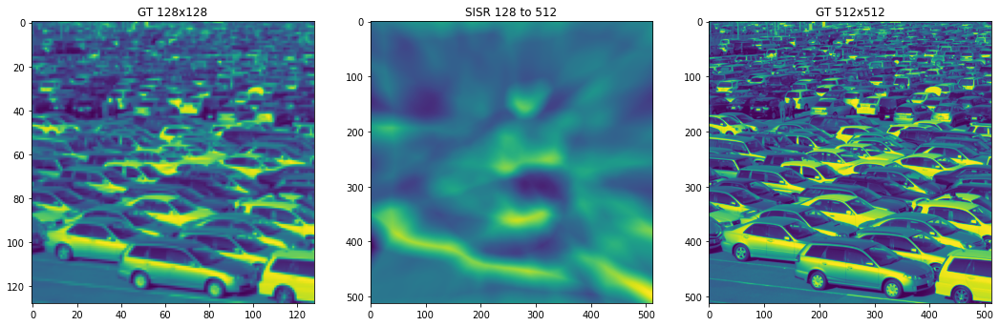

PSNR: 12.922746404024005
SSIM: 0.17890440331079502


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
relu_net = modules.SingleBVPNet(type='relu', mode='mlp', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = relu_net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']
    loss = loss_functions.image_mse(model_output, coords, gt['img'])

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
relu_sisr = hr_img.cpu().detach()
psnrs_relu_sisr = psnrs
ssims_relu_sisr = ssims
psnr_relu_sisr = psnrs[-1]
ssim_relu_sisr = ssims[-1]

print('PSNR:', psnr_relu_sisr)
print('SSIM:', ssim_relu_sisr)

### 6.1.4 - ReLU with VGG loss

SingleBVPNet(
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=2, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 231.589615
GPU Memory occupation: 4.3 / 14.8 GB
Step 100, Total loss 107.398315
GPU Memory occupation: 4.4 / 14.8 GB
Step 200, Total loss 104.219765
GPU Memory occupation: 4.4 / 14.8 GB
Step 300, Total loss 101.4

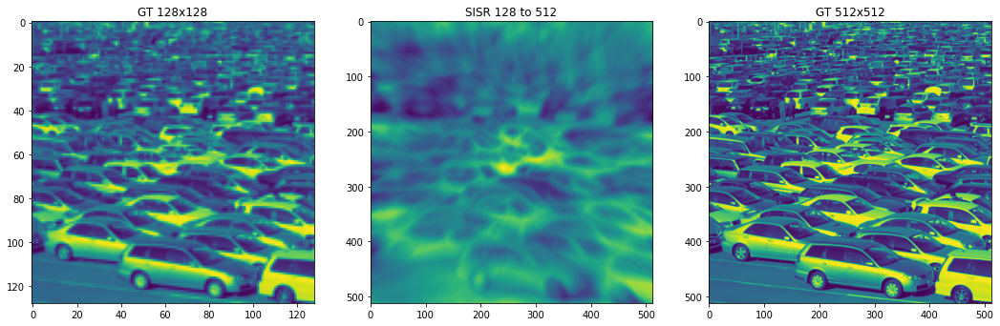

PSNR: 12.032588050823103
SSIM: 0.1756892778733219


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
relu_net = modules.SingleBVPNet(type='relu', mode='mlp', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = relu_net.cuda()

loss_fn = loss_functions.VGGPerceptualLoss().cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']

    # Adapt images for VGG
    _y = model_output.view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    _gt = gt['img'].view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    loss = loss_fn(_y, _gt)

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
relu_vgg_sisr = hr_img.cpu().detach()
psnrs_relu_vgg_sisr = psnrs
ssims_relu_vgg_sisr = ssims
psnr_relu_vgg_sisr = psnrs[-1]
ssim_relu_vgg_sisr = ssims[-1]

print('PSNR:', psnr_relu_vgg_sisr)
print('SSIM:', ssim_relu_vgg_sisr)

### 6.1.5 - ReLU with P.E.

SingleBVPNet(
  (positional_encoding): PosEncodingNeRF()
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=22, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 3.704372
GPU Memory occupation: 4.3 / 14.8 GB
Step 100, Total loss 0.209184
GPU Memory occupation: 4.3 / 14.8 GB
Step 200, Total loss 0.140441
GPU Memory occupation: 4.

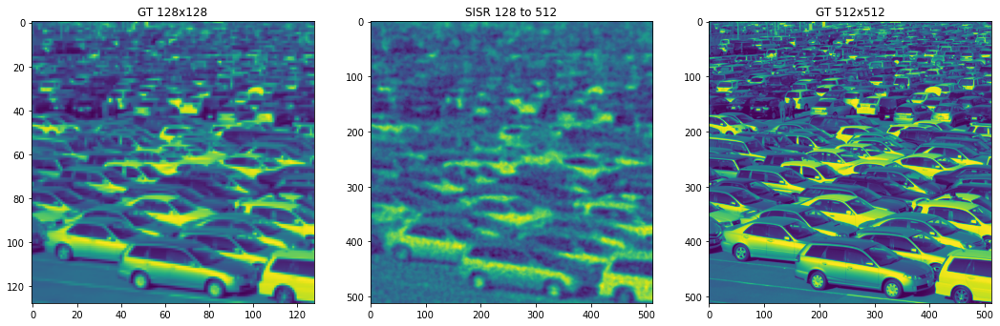

PSNR: 16.5230497553393
SSIM: 0.35013422731047716


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
relu_net = modules.SingleBVPNet(type='relu', mode='nerf', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = relu_net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']
    loss = loss_functions.image_mse(model_output, coords, gt['img'])

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
relu_nerf_sisr = hr_img.cpu().detach()
psnrs_relu_nerf_sisr = psnrs
ssims_relu_nerf_sisr = ssims
psnr_relu_nerf_sisr = psnrs[-1]
ssim_relu_nerf_sisr = ssims[-1]

print('PSNR:', psnr_relu_nerf_sisr)
print('SSIM:', ssim_relu_nerf_sisr)

### 6.1.6 - ReLU with P.E. and VGG loss

SingleBVPNet(
  (positional_encoding): PosEncodingNeRF()
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=22, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 252.636307
GPU Memory occupation: 4.4 / 14.8 GB
Step 100, Total loss 90.869919
GPU Memory occupation: 4.5 / 14.8 GB
Step 200, Total loss 46.839432
GPU Memory occupation

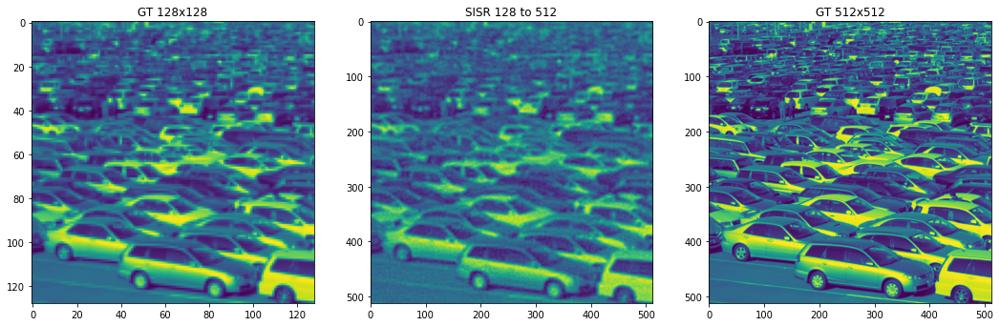

PSNR: 17.48271893503087
SSIM: 0.47018253607139376


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
relu_net = modules.SingleBVPNet(type='relu', mode='nerf', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = relu_net.cuda()

loss_fn = loss_functions.VGGPerceptualLoss().cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']

    # Adapt images for VGG
    _y = model_output.view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    _gt = gt['img'].view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    loss = loss_fn(_y, _gt)

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
relu_nerf_vgg_sisr = hr_img.cpu().detach()
psnrs_relu_nerf_vgg_sisr = psnrs
ssims_relu_nerf_vgg_sisr = ssims
psnr_relu_nerf_vgg_sisr = psnrs[-1]
ssim_relu_nerf_vgg_sisr = ssims[-1]

print('PSNR:', psnr_relu_nerf_vgg_sisr)
print('SSIM:', ssim_relu_nerf_vgg_sisr)

### 6.1.7 - Collect and compare results

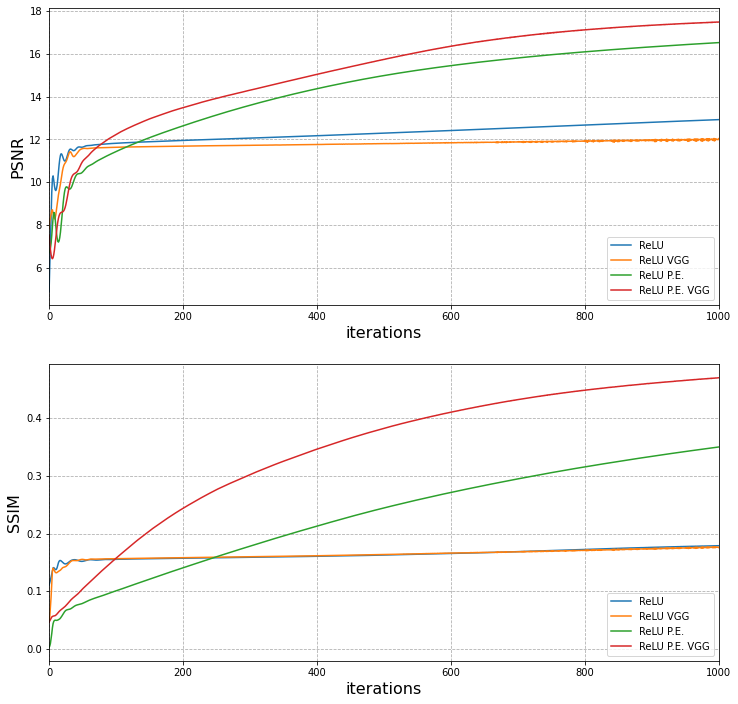

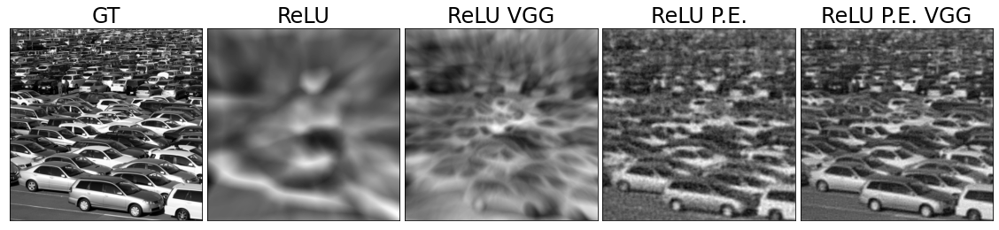

SISR 128x128 to 512x512
hidden layers: 3
hidden features: 256
total steps: 1000


PSNR:
	ReLU: 12.922746
	ReLU VGG: 12.032588
	ReLU P.E.: 16.523050
	ReLU P.E. VGG: 17.482719


SSIM:
	ReLU: 0.178904
	ReLU VGG: 0.175689
	ReLU P.E.: 0.350134
	ReLU P.E. VGG: 0.470183


In [ ]:
psnr_data = {
    'ReLU' : psnrs_relu_sisr,
    'ReLU VGG' : psnrs_relu_vgg_sisr,
    'ReLU P.E.' : psnrs_relu_nerf_sisr,
    'ReLU P.E. VGG' : psnrs_relu_nerf_vgg_sisr,
    }
ssim_data = {
    'ReLU' : ssims_relu_sisr,
    'ReLU VGG' : ssims_relu_vgg_sisr,
    'ReLU P.E.' : ssims_relu_nerf_sisr,
    'ReLU P.E. VGG' : ssims_relu_nerf_vgg_sisr,
    }

myutils.plot_psnr_and_ssim(psnr_data, ssim_data, total_steps, save=True, fname='psnr_and_ssim_sisr_relu.png')

images = {
    'GT' : gt_sisr,
    'ReLU' : relu_sisr,
    'ReLU VGG' : relu_vgg_sisr,
    'ReLU P.E.' : relu_nerf_sisr,
    'ReLU P.E. VGG' : relu_nerf_vgg_sisr,
    }

def print_sisr_grid(images, sidelength=512, figsize=(20, 4), textsize=24, fname='sisr_grid_relu.png'):
    ''' Create custom figure with grid (GT, SIREN, SIREN VGG, ReLU-Nerf, Bicubic, SRGAN)'''

    fig = plt.figure(constrained_layout=False, figsize=figsize)
    gs = fig.add_gridspec(1, len(images), wspace=0, hspace=0)

    for i, (key, value) in enumerate(images.items()):
        a1 = fig.add_subplot(gs[0, i])
        a1.imshow(value.cpu().view(sidelength, sidelength).detach().numpy(), cmap='gray')
        a1.set_xticks([])
        a1.set_yticks([])
        a1.set_title(key, fontsize=textsize)
    plt.savefig(fname=fname, bbox_inches='tight')
    plt.show()

print_sisr_grid(images, sidelength=hr_sidelength)

print('SISR %dx%d to %dx%d' % (lr_sidelength, lr_sidelength, hr_sidelength, hr_sidelength))
print('hidden layers: %d' % (HIDDEN_LAYERS))
print('hidden features: %d' % (HIDDEN_FEATURES))
print('total steps: %d' % (TOTAL_STEPS))
print('\n')

print('PSNR:')
for key, val in psnr_data.items():
    print('\t' + key + ': %0.6f' % (val[-1]))
print('\n')
print('SSIM:')
for key, val in ssim_data.items():
    print('\t' + key + ': %0.6f' % (val[-1]))

## 6.2 - Compare SIREN classic, VGG and P.E.

### 6.2.1 - Define config

In [ ]:
import box
import PIL
from torchvision.utils import save_image
from torchvision.transforms import Resize, Compose, ToPILImage, ToTensor, Normalize
from PIL import Image

subsets = {
    # 'bicubic_x2' : 'all',
    # 'unknown_x2' : 'all',
    # 'bicubic_x3' : 'all',
    # 'unknown_x3' : 'all',
    # 'bicubic_x4' : 'all',
    # 'unknown_x4' : 'all',
    # 'bicubic_x8' : 'all',
    # 'mild_x4' : 'all',
    # 'difficult_x4' : 'all',
    # 'wild_x4' : 'all',
    'HR_images' : 'train',
    }

# max cameramen image = 512x512
# max starfish image = 481x321
# 224: avoid VVG loss interpolation
lr_sidelength = 128 # 128, 224, 256
hr_sidelength = 512 # 256, 512

dataset_type = 'div2k' # skimage, div2k

# Choose image type for skimage
img_type = 'cameraman' # cameraman, starfish

# Choose index for DIV2K
div2k_index = 143

# Config the network
LR = 1e-4
HIDDEN_LAYERS = 3 # 2, 3, 5, 10
HIDDEN_FEATURES = 256 # 256. 512
VERBOSE = False
TOTAL_STEPS = 100 # 500, 1000
STEPS_TIL_SUMMARY = TOTAL_STEPS*0.1

idx_recommended = [
    2,      # palma
    21,     # paesaggio
    28,     # affreschi
    33,     # carrozza
    49,     # quadro contemporaneo
    51,     # città
    68,     # donna
    82,     # paesaggio con fiume
    89,     # uomo
    109,    # asiatici
    143,    # auto
    159,    # verdura
    177,    # cammelli
    181,    # tempio
]
idx_to_sample = [div2k_index] # only the first one will be considered

### 6.1.2 - Prepare Dataset and Dataloader

In [ ]:
if dataset_type == 'skimage':
    lr_dataset = PoissonEqn(lr_sidelength, img_type=img_type, gradients=False, laplace=False)
    hr_dataset = PoissonEqn(hr_sidelength, img_type=img_type, gradients=False, laplace=False)
elif dataset_type == 'div2k':
    if not os.path.isdir('data/DIV2K'):
        DIV2K_loader.DIV2KImport(sets=subsets)
    lr_dataset = DIV2KImageDataset(subsets=subsets, sidelength=lr_sidelength ,transform=default_transform(lr_sidelength), idx_to_sample=idx_to_sample, with_coords=True)
    hr_dataset = DIV2KImageDataset(subsets=subsets, sidelength=hr_sidelength, transform=default_transform(hr_sidelength), idx_to_sample=idx_to_sample, with_coords=True)
else:
    raise Exception('Unexpected dataset type') 

lr_dataloader = DataLoader(lr_dataset, batch_size=1, pin_memory=True, num_workers=0)

model_input, gt = next(iter(lr_dataloader))
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

hr_dataloader = DataLoader(hr_dataset, batch_size=1, pin_memory=True, num_workers=0)

hr_grid, hr_gt = next(iter(hr_dataloader))
gt_sisr = hr_gt['img']
hr_gt = {key: value.cuda() for key, value in hr_gt.items()}
hr_grid = hr_grid.cuda()

['data/DIV2K/train/DIV2K_train_HR/']
['data/DIV2K/train/DIV2K_train_HR/']


### 6.2.3 - Classic SIREN

SingleBVPNet(
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=2, out_features=256, bias=True)
        (1): Sine()
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 0.234190
GPU Memory occupation: 5.3 / 14.8 GB
Step 10, Total loss 0.135378
GPU Memory occupation: 5.3 / 14.8 GB
Step 20, Total loss 0.090464
GPU Memory occupation: 5.3 / 14.8 GB
Step 30, Total loss 0.061005
GPU Memory occupation: 5.3 / 14.8 GB
Step 40, Total l

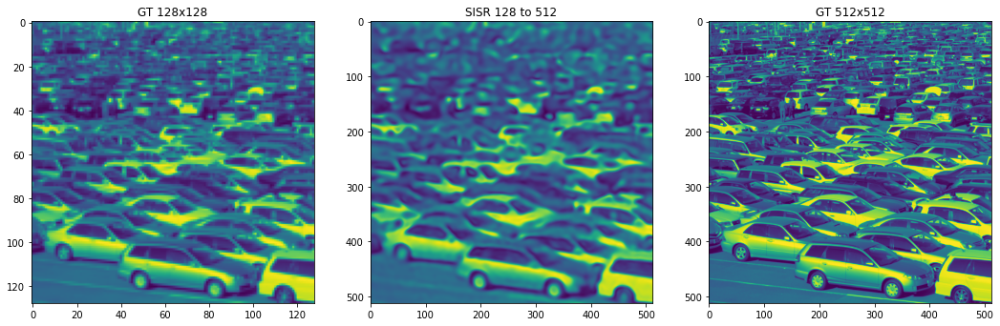

PSNR: 17.46902110744403
SSIM: 0.4474692131597348


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
siren_net = modules.SingleBVPNet(type='sine', mode='mlp', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = siren_net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']
    loss = loss_functions.image_mse(model_output, coords, gt['img'])

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
siren_sisr = hr_img.cpu().detach()
psnrs_siren_sisr = psnrs
ssims_siren_sisr = ssims
psnr_siren_sisr = psnrs[-1]
ssim_siren_sisr = ssims[-1]

print('PSNR:', psnr_siren_sisr)
print('SSIM:', ssim_siren_sisr)

### 6.2.4 - SIREN with VGG loss

SingleBVPNet(
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=2, out_features=256, bias=True)
        (1): Sine()
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 120.102959
GPU Memory occupation: 5.4 / 14.8 GB
Step 10, Total loss 83.821014
GPU Memory occupation: 5.5 / 14.8 GB
Step 20, Total loss 63.517490
GPU Memory occupation: 5.5 / 14.8 GB
Step 30, Total loss 46.867210
GPU Memory occupation: 5.5 / 14.8 GB
Step 40, To

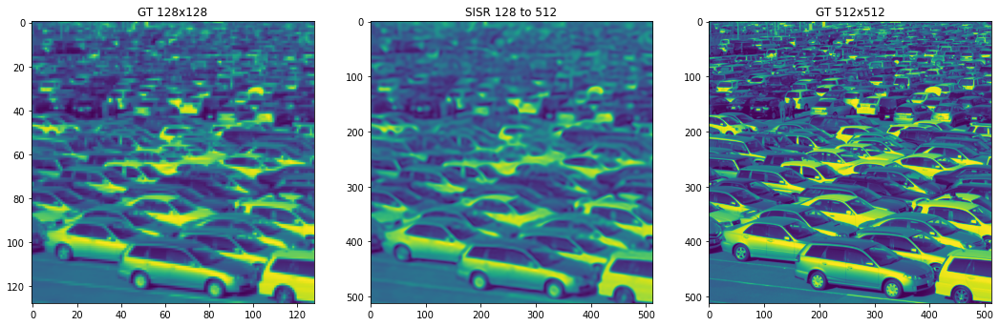

PSNR: 17.63129168831326
SSIM: 0.49573536417408226


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
siren_net = modules.SingleBVPNet(type='sine', mode='mlp', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = siren_net.cuda()

loss_fn = loss_functions.VGGPerceptualLoss().cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']

    # Adapt images for VGG
    _y = model_output.view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    _gt = gt['img'].view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    loss = loss_fn(_y, _gt)

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
siren_vgg_sisr = hr_img.cpu().detach()
psnrs_siren_vgg_sisr = psnrs
ssims_siren_vgg_sisr = ssims
psnr_siren_vgg_sisr = psnrs[-1]
ssim_siren_vgg_sisr = ssims[-1]

print('PSNR:', psnr_siren_vgg_sisr)
print('SSIM:', ssim_siren_vgg_sisr)

### 6.2.5 - SIREN with P.E.

SingleBVPNet(
  (positional_encoding): PosEncodingNeRF()
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=22, out_features=256, bias=True)
        (1): Sine()
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): Sine()
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 0.262811
GPU Memory occupation: 5.4 / 14.8 GB
Step 10, Total loss 0.165368
GPU Memory occupation: 5.4 / 14.8 GB
Step 20, Total loss 0.068551
GPU Memory occupation: 5.4 / 14.8 GB
Step 30, Total loss 0.023065
GPU Memor

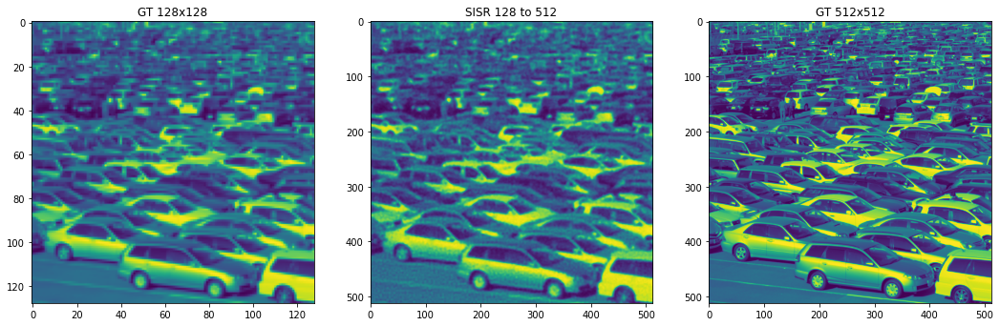

PSNR: 18.435075970519136
SSIM: 0.5503296112755981


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
siren_net = modules.SingleBVPNet(type='sine', mode='nerf', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = siren_net.cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']
    loss = loss_functions.image_mse(model_output, coords, gt['img'])

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
siren_nerf_sisr = hr_img.cpu().detach()
psnrs_siren_nerf_sisr = psnrs
ssims_siren_nerf_sisr = ssims
psnr_siren_nerf_sisr = psnrs[-1]
ssim_siren_nerf_sisr = ssims[-1]

print('PSNR:', psnr_siren_nerf_sisr)
print('SSIM:', ssim_siren_nerf_sisr)

### 6.2.6 - SIREN with P.E. and VGG loss

SingleBVPNet(
  (positional_encoding): PosEncodingNeRF()
  (image_downsampling): ImageDownsampling()
  (net): FCBlock(
    (net): MetaSequential(
      (0): MetaSequential(
        (0): BatchLinear(in_features=22, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (1): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (2): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (3): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=256, bias=True)
        (1): ReLU(inplace=True)
      )
      (4): MetaSequential(
        (0): BatchLinear(in_features=256, out_features=1, bias=True)
      )
    )
  )
)
Step 0, Total loss 170.513214
GPU Memory occupation: 4.4 / 14.8 GB
Step 10, Total loss 139.630310
GPU Memory occupation: 4.5 / 14.8 GB
Step 20, Total loss 128.036575
GPU Memory occupation

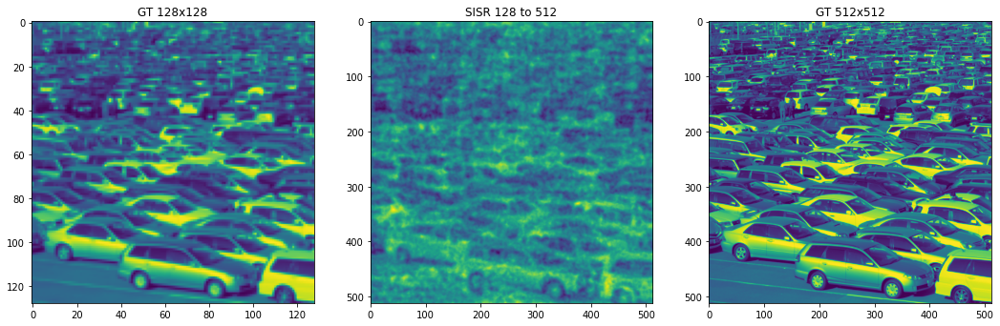

PSNR: 12.982116679364392
SSIM: 0.20409701565622804


In [ ]:
sys.path.append('siren/src/include/siren')
import modules

input = {'coords' : model_input}
hr_input = {'coords' : hr_grid}

# Create the network
siren_net = modules.SingleBVPNet(type='relu', mode='nerf', hidden_features=HIDDEN_FEATURES, num_hidden_layers=HIDDEN_LAYERS, sidelength=lr_sidelength)
model = siren_net.cuda()

loss_fn = loss_functions.VGGPerceptualLoss().cuda()

# Define optimizer
optim = torch.optim.Adam(lr=LR, params=model.parameters())

total_steps = TOTAL_STEPS
steps_til_summary = STEPS_TIL_SUMMARY
verbose = VERBOSE # True, False

psnrs = []
ssims = []

for step in range(total_steps+1):
    model_output = model(input)    
    coords = model_output['model_in']
    model_output = model_output['model_out']
    hr_img = model(hr_input)    
    hr_img = hr_img['model_out']

    # Adapt images for VGG
    _y = model_output.view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    _gt = gt['img'].view(lr_sidelength, lr_sidelength).unsqueeze(0).unsqueeze(0)
    loss = loss_fn(_y, _gt)

    psnrs.append(myutils.img_psnr(hr_img, hr_gt['img'], hr_sidelength))
    ssims.append(myutils.img_ssim(hr_img, hr_gt['img'], hr_sidelength))
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        print('GPU Memory occupation: %0.1f / %0.1f GB' % (torch.cuda.memory_allocated(0) / (1024 ** 3), torch.cuda.get_device_properties(0).total_memory / (1024 ** 3)))
        
        if verbose or step == total_steps:
            _, axes = plt.subplots(1, 3, figsize=(18,6))
            axes[0].imshow(gt['img'].cpu().view(lr_sidelength, lr_sidelength).detach().numpy())
            axes[0].set_title('GT '+ str(lr_sidelength) + 'x' + str(lr_sidelength))
            axes[1].imshow(hr_img.cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[1].set_title('SISR ' + str(lr_sidelength) + ' to ' + str(hr_sidelength))
            axes[2].imshow(hr_gt['img'].cpu().view(hr_sidelength, hr_sidelength).detach().numpy())
            axes[2].set_title('GT ' + str(hr_sidelength) + 'x' + str(hr_sidelength))
            plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

# Collect data to compare results
siren_nerf_vgg_sisr = hr_img.cpu().detach()
psnrs_siren_nerf_vgg_sisr = psnrs
ssims_siren_nerf_vgg_sisr = ssims
psnr_siren_nerf_vgg_sisr = psnrs[-1]
ssim_siren_nerf_vgg_sisr = ssims[-1]

print('PSNR:', psnr_siren_nerf_vgg_sisr)
print('SSIM:', ssim_siren_nerf_vgg_sisr)

### 6.2.7 - Collect and compare results

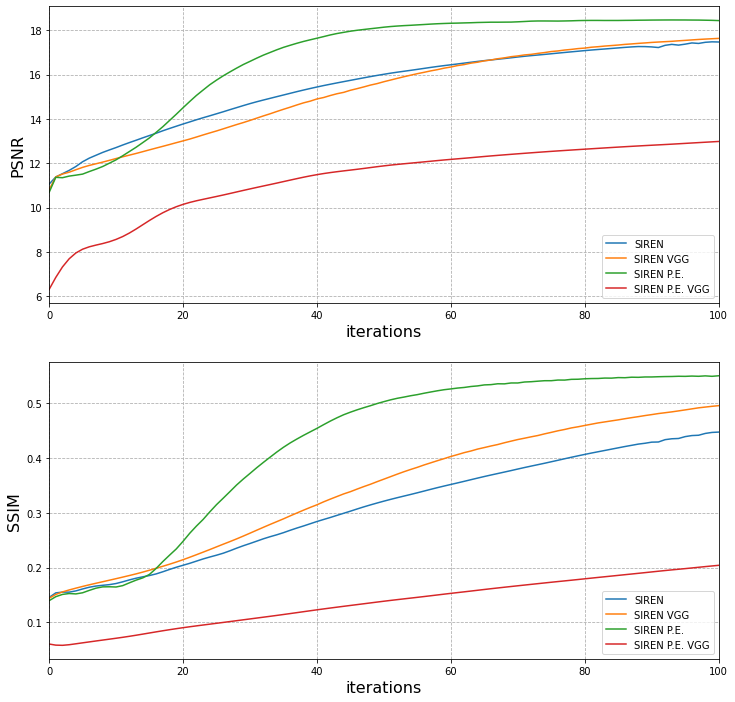

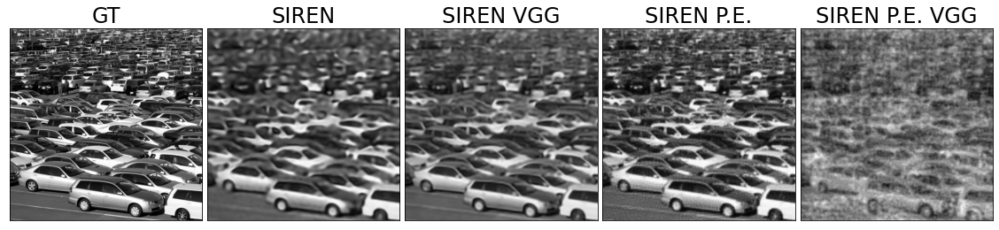

SISR 128x128 to 512x512
hidden layers: 3
hidden features: 256
total steps: 100


PSNR:
	SIREN: 17.469021
	SIREN VGG: 17.631292
	SIREN P.E.: 18.435076
	SIREN P.E. VGG: 12.982117


SSIM:
	SIREN: 0.447469
	SIREN VGG: 0.495735
	SIREN P.E.: 0.550330
	SIREN P.E. VGG: 0.204097


In [ ]:
psnr_data = {
    'SIREN' : psnrs_siren_sisr,
    'SIREN VGG' : psnrs_siren_vgg_sisr,
    'SIREN P.E.' : psnrs_siren_nerf_sisr,
    'SIREN P.E. VGG' : psnrs_siren_nerf_vgg_sisr,
    }
ssim_data = {
    'SIREN' : ssims_siren_sisr,
    'SIREN VGG' : ssims_siren_vgg_sisr,
    'SIREN P.E.' : ssims_siren_nerf_sisr,
    'SIREN P.E. VGG' : ssims_siren_nerf_vgg_sisr,
    }

myutils.plot_psnr_and_ssim(psnr_data, ssim_data, total_steps, save=True, fname='psnr_and_ssim_sisr_siren.png')

images = {
    'GT' : gt_sisr,
    'SIREN' : siren_sisr,
    'SIREN VGG' : siren_vgg_sisr,
    'SIREN P.E.' : siren_nerf_sisr,
    'SIREN P.E. VGG' : siren_nerf_vgg_sisr,
    }

def print_sisr_grid(images, sidelength=512, figsize=(20, 4), textsize=24, fname='sisr_grid_siren.png'):
    fig = plt.figure(constrained_layout=False, figsize=figsize)
    gs = fig.add_gridspec(1, len(images), wspace=0, hspace=0)

    for i, (key, value) in enumerate(images.items()):
        a1 = fig.add_subplot(gs[0, i])
        a1.imshow(value.cpu().view(sidelength, sidelength).detach().numpy(), cmap='gray')
        a1.set_xticks([])
        a1.set_yticks([])
        a1.set_title(key, fontsize=textsize)
    plt.savefig(fname=fname, bbox_inches='tight')
    plt.show()

print_sisr_grid(images, sidelength=hr_sidelength)

print('SISR %dx%d to %dx%d' % (lr_sidelength, lr_sidelength, hr_sidelength, hr_sidelength))
print('hidden layers: %d' % (HIDDEN_LAYERS))
print('hidden features: %d' % (HIDDEN_FEATURES))
print('total steps: %d' % (TOTAL_STEPS))
print('\n')

print('PSNR:')
for key, val in psnr_data.items():
    print('\t' + key + ': %0.6f' % (val[-1]))
print('\n')
print('SSIM:')
for key, val in ssim_data.items():
    print('\t' + key + ': %0.6f' % (val[-1]))